In [1]:
import numpy as np
import pandas as pd
from scipy.stats import norm, uniform, dirichlet

import sys, time
import itertools
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
hmm = pd.DataFrame([],columns=['states','observations'])
hmm.head()

,states,observations


In [71]:
def timeprint(iterator,plot=False):
    times = []
    idx = 1
    for thing in iterator:
        prev_time = time.time()
        yield thing
        times.append(time.time() - prev_time)
        sys.stdout.write('Step {} done in {:.4f}sec   \r'.format(idx,times[idx-1]))
        idx += 1
        sys.stdout.flush()
    print('\n{:.4f}sec avg, {:.4f}sec total\n'.format(np.mean(times),np.sum(times)))
    
    if plot:
        plt.boxplot(times)
        plt.ylabel('time in sec')
        plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off')
        plt.title('boxplot of time for each step');

In [3]:
def sample_init(dist, **params):
    if dist == 'discrete':
        assert 'Nb_states' in params and 'obs_params' in params
        Nb_states = params['Nb_states']
        obs_params = params['obs_params']
        
        state_init = np.random.randint(Nb_states)
        obs_init = norm.rvs(**obs_params[state_init])
        
    elif dist == 'gaussian':
        assert 'mu' in params and 'sigma' in params and 'emission' in params and 'obs_noise' in params
        
        state_init = norm.rvs(loc=params['mu'],scale=params['sigma'])
        obs_init = np.dot(params['emission'],state_init)+norm.rvs(**params['obs_noise'])
        
    return state_init, obs_init

def sample_next(current_state, dist, **params):
    if dist == 'discrete':
        assert 'Nb_states' in params and 'transition_mat' in params and 'obs_params' in params
        Nb_states = params['Nb_states']
        transition_mat = params['transition_mat']
        obs_params = params['obs_params']
        
        next_state = np.random.choice(Nb_states,p=transition_mat[current_state])
        next_obs = norm.rvs(**obs_params[next_state])
        
    elif dist == 'gaussian':
        assert 'transition' in params and 'state_noise' in params and 'emission' in params and 'obs_noise' in params
        
        next_state = np.dot(params['transition'],current_state)+norm.rvs(**params['state_noise'])
        next_obs = np.dot(params['emission'],next_state)+norm.rvs(**params['obs_noise'])
        
    return next_state, next_obs

def generate(T,dist='discrete',**params):
    hmm = pd.DataFrame(np.zeros((T,2)),columns=['states','observations'])
    hmm['states'] = hmm['states'].astype(np.int64)
    state_init, obs_init = sample_init(dist,**params)
    hmm.iloc[0,:] = [state_init,obs_init]
    
    for t in np.arange(1,T):
        next_state, next_obs = sample_next(hmm['states'][t-1],dist,**params)
        hmm.iloc[t,:] = [next_state,next_obs]
        
    return hmm

In [4]:
params_discrete = {'Nb_states': 3, 'transition_mat': np.array([[0.2,0.5,0.3],[0.1,0.4,0.5],[0.8,0.1,0.1]]),
          'obs_params': {0:{'loc':0,'scale':1},1:{'loc':20,'scale':4},2:{'loc':100,'scale':10}}}
params_gaussian = {'mu': 5., 'sigma': 4., 'transition': 1.5, 'emission': 0.8,
                   'state_noise':{'loc':0, 'scale':1}, 'obs_noise':{'loc':0, 'scale':2.}}

params = params_discrete
hmm = generate(100,dist='discrete',**params)
hmm

,states,observations
0,1,16.963268
1,1,16.967700
2,2,106.930951
3,0,0.133867
4,1,20.273005
5,2,94.672954
6,0,-0.861025
7,0,-0.133008
8,1,19.035511
9,1,23.039408


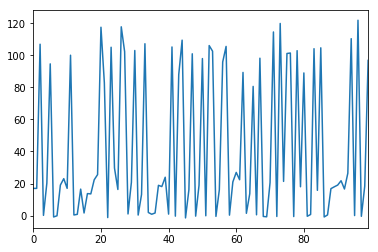

In [5]:
hmm['observations'].plot();

In [6]:
def init_naive(**args):
    init_particles = np.random.randint(args['Nb_states'],size=args['N'])
    init_w = [norm.pdf(args['obs'],**args['obs_params'][particle]) for particle in init_particles]
    return init_particles, init_w

def init_opt(**args):
    transition_prob = [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    init_w = np.repeat(np.sum(transition_prob),args['N'])
    transition_prob = transition_prob/np.sum(transition_prob)
    init_particles = [np.random.choice(args['Nb_states'],p=transition_prob) for _ in range(args['N'])]
    return init_particles, init_w

def next_step_naive(**args):
    particle = np.random.choice(args['Nb_states'],p=args['transition_mat'])
    w = args['weights'] * norm.pdf(args['obs'],**args['obs_params'][particle])
    return particle, w

def next_step_opt(**args):
    transition_prob = args['transition_mat'] * [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    w = args['weights'] * np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return particle, w

In [7]:
def unique_particlesWeights(particles,weights):
    n = particles.shape[0]
    particles_tupled = [tuple(col) for col in particles.T]
    set_particles = set(particles_tupled)
    unique_id_weights = [np.where(np.sum(particles.T == particle,1)==n)[0] for particle in set_particles]
    unique_weights = [np.sum(weights[n-1,idx]) for idx in unique_id_weights]
    unique_id_particles = [idx[0] for idx in unique_id_weights]
    unique_particles = particles[:,unique_id_particles]
    return unique_particles, unique_weights
    

def estimate_states(particles,weights):
    unique_particles, unique_weights = unique_particlesWeights(particles,weights)
    return unique_particles[:,np.argmax(unique_weights)]

def accuracy(true_states,estimated_states):
    n = len(true_states)
    return np.sum(estimated_states == true_states) / float(n)

In [8]:
def Sequential_IS(obs,N=10,importance_dist='opt',plot=False,verbose=1,**params):
    if importance_dist == 'opt':
        init = init_opt
        next_step = next_step_opt
    elif importance_dist == 'naive':
        init = init_naive
        next_step = next_step_naive
    n = len(obs)
    if verbose == 0:
        iterator = np.arange(1,n)
    elif verbose == 1:
        iterator = timeprint(np.arange(1,n),plot)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    assert 'Nb_states' in params and 'transition_mat' in params and 'obs_params' in params
    Nb_states = params['Nb_states']
    transition_mat = params['transition_mat']
    obs_params = params['obs_params']
    
    # Initialization
    particles[0,:], w[0,:] = init(Nb_states=Nb_states,N=N,obs=obs[0],obs_params=obs_params)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    
    # Iterations
    for k in iterator:
        for i in range(N):
            particles[k,i], w[k,i] = next_step(Nb_states=Nb_states,transition_mat=transition_mat[particles[k-1,i]],obs=obs[k],obs_params=obs_params,weights=weights[k-1,i])
        #print(w[k,:],np.sum(w[k,:]))
        weights[k,:] = w[k,:]/np.sum(w[k,:])
    
    return particles, weights

Step 99 done in 0.0027sec   
0.0028sec avg, 0.2729sec total



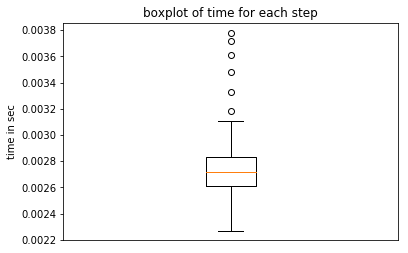

In [9]:
particles, weights = Sequential_IS(hmm['observations'].values,N=10,importance_dist='opt',plot=True,verbose=1,**params)

In [10]:
estimated_states = estimate_states(particles,weights)
accuracy(hmm['states'],estimated_states)

1.0

In [11]:
def compute_offsprings(W,N):
    weights_cumsum = np.hstack((0,np.cumsum(W)))
    offsprings = np.zeros(N,dtype=np.int64)
    U = uniform.rvs(scale=1./N)
    U_inc = 0
    for i in np.arange(1,N+1):
        while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
            offsprings[i-1] = offsprings[i-1] + 1
            U_inc = U_inc + 1./N
    return offsprings

def SIR(obs,N=10,estimator='hat',importance_dist='opt',plot=False,verbose=1,**params):
    if importance_dist == 'opt':
        init = init_opt
        next_step = next_step_opt
    elif importance_dist == 'naive':
        init = init_naive
        next_step = next_step_naive
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'transition_mat' in params and 'obs_params' in params
    Nb_states = params['Nb_states']
    transition_mat = params['transition_mat']
    obs_params = params['obs_params']
    
    ### Initialization ###
    particles[0,:], w[0,:] = init(Nb_states=Nb_states,N=N,obs=obs[0],obs_params=obs_params)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    # Resample
    offsprings = compute_offsprings(weights[0,:],N)
    particles[0,:] = np.repeat(particles[0,:],offsprings)
    weights[0,:] = np.repeat(1./N,N)
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        for i in range(N):
            particles[k,i], w[k,i] = next_step(Nb_states=Nb_states,transition_mat=transition_mat[particles[k-1,i]],obs=obs[k],obs_params=obs_params,weights=1)
            
        if np.sum(w[k,:]) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k,:] = np.repeat(1./N,N)
        else:
            weights[k,:] = w[k,:]/np.sum(w[k,:])
            
        if verbose == 2:
            print('particles before offsprings',particles[k,:])
            print('w', w[k,:])
            print('weights',weights[k,:])
        
        if k == n-1 and estimator == 'hat':
            continue
        
        # Resample
        offsprings = compute_offsprings(weights[k,:],N)
        offsprings_pos = offsprings[offsprings>0]
        particles[0:k,:] = np.array([col for idx, col in enumerate(particles[0:k,offsprings>0].T) for _ in range(offsprings_pos[idx])]).T
        #particles[k,:] = np.repeat(particles[k,:],offsprings)
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after offsprings',particles[k,:])
        weights[k,:] = np.repeat(1./N,N)
    
    return particles, weights

Step 99 done in 0.0029sec   
0.0029sec avg, 0.2834sec total



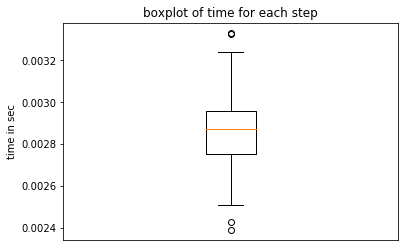

In [12]:
particles, weights = SIR(hmm['observations'].values,N=10,importance_dist='opt',plot=True,verbose=1,**params)

In [13]:
estimated_states = estimate_states(particles,weights)
accuracy(hmm['states'],estimated_states)

1.0

In [14]:
def SIR_AR(obs,N=10,importance_dist='opt',resampling_threshold=None,estimator='hat',plot=False,verbose=1,**params):
    if importance_dist == 'opt':
        init = init_opt
        next_step = next_step_opt
    elif importance_dist == 'naive':
        init = init_naive
        next_step = next_step_naive
    resampling_threshold = N/2. if resampling_threshold is None else resampling_threshold
    assert resampling_threshold>=1. and resampling_threshold<=N
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'transition_mat' in params and 'obs_params' in params
    Nb_states = params['Nb_states']
    transition_mat = params['transition_mat']
    obs_params = params['obs_params']
    #e = 0
    
    ### Initialization ###
    particles[0,:], w[0,:] = init(Nb_states=Nb_states,N=N,obs=obs[0],obs_params=obs_params)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    # Resample
    ESS = 1./np.sum(weights[0,:]**2)
    if ESS <= resampling_threshold:
        offsprings = compute_offsprings(weights[0,:],N)
        particles[0,:] = np.repeat(particles[0,:],offsprings)
        weights[0,:] = np.repeat(1./N,N)
        #e+=1
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        for i in range(N):
            particles[k,i], w[k,i] = next_step(Nb_states=Nb_states,transition_mat=transition_mat[particles[k-1,i]],obs=obs[k],obs_params=obs_params,weights=weights[k-1,i])
        if np.sum(w[k,:]) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k,:] = np.repeat(1./N,N)
        else:
            weights[k,:] = w[k,:]/np.sum(w[k,:])
            
        if verbose == 2:
            print('particles before offsprings',particles[k,:])
            print('w', w[k,:])
            print('weights',weights[k,:])
        
        if k == n-1 and estimator == 'hat':
            continue
        
        # Resample
        ESS = 1./np.sum(weights[k,:]**2)
        if ESS <= resampling_threshold:
            offsprings = compute_offsprings(weights[k,:],N)
            offsprings_pos = offsprings[offsprings>0]
            particles[0:k,:] = np.array([col for idx, col in enumerate(particles[0:k,offsprings>0].T) for _ in range(offsprings_pos[idx])]).T
            #particles[k,:] = np.repeat(particles[k,:],offsprings)
            if verbose == 2:
                print('offsprings',offsprings)
                print('particles after offsprings',particles[k,:])
            weights[k,:] = np.repeat(1./N,N)
            #e+=1
    #print('number of resamples: {}'.format(e))
    return particles, weights

Step 99 done in 0.0027sec   
0.0028sec avg, 0.2765sec total



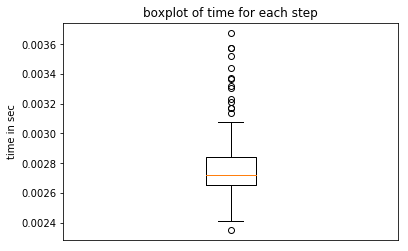

In [15]:
particles, weights = SIR_AR(hmm['observations'].values,N=10,importance_dist='opt',plot=True,verbose=1,**params)

In [16]:
estimated_states = estimate_states(particles,weights)
accuracy(hmm['states'],estimated_states)

1.0

In [17]:
def run_particles(algo,true_values,Nb_run,Nb_particles,importance_dist='naive',paired=False,verbose=0):
    if type(Nb_run) != np.ndarray:
        Nb_run = np.array(Nb_run)
    if type(Nb_particles) != np.ndarray:
        Nb_particles = np.array(Nb_particles) 
    Nb_run = Nb_run.reshape(1,-1)
    Nb_particles = Nb_particles.reshape(1,-1)
    if paired and Nb_run.shape != Nb_particles.shape:
        raise ValueError("The shape of Nb_run and Nb_particles must match if paired=True")
    
    if paired:
        Nb_experiment = Nb_run.shape[1]
    else:
        Nb_experiment = Nb_particles.shape[1]*Nb_run.shape[1]
    if verbose == 1:
        plt.figure(figsize=(5,5*Nb_experiment))
        gs = gridspec.GridSpec(Nb_experiment, 1)
    #accuracies = np.zeros((Nb_particles.shape[1],Nb_run.shape[1]))
    index = pd.MultiIndex(levels=[[],[]],labels=[[],[]],names=['Nb_run','id'])
    accuracies = pd.DataFrame([],index=index,columns=Nb_particles[0])
    
    if paired:
        for idx, (run, particle) in enumerate(zip(Nb_run[0],Nb_particles[0])):
            if verbose == 0:
                iterator_run = range(run)
            elif verbose == 1:
                print('----- {} runs of {} particles -----'.format(run,particle))
                iterator_run = timeprint(range(run))
            for i in iterator_run:
                particles, weights = algo(true_values['observations'].values,N=particle,importance_dist=importance_dist,verbose=0,**params)
                estimated_states = estimate_states(particles,weights)
                #accuracies[idx_particle,idx_run] = accuracy(true_values['states'],estimated_states)
                accuracies.set_value((run,i), particle, accuracy(true_values['states'],estimated_states))

            if verbose == 1:
                print('')
                ax = plt.subplot(gs[idx, 0])
                ax.boxplot(accuracies.loc[(run, slice(None)), particle].values)
                ax.set_ylabel('accuracy')
                ax.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off')
                ax.set_title('boxplot of accuracy for {} runs with {} particles'.format(run,particle));
    else:
        for idx_run, run in enumerate(Nb_run[0]):
            for idx_particle, particle in enumerate(Nb_particles[0]):
                if verbose == 0:
                    iterator_run = range(run)
                elif verbose == 1:
                    print('----- {} runs of {} particles -----'.format(run,particle))
                    iterator_run = timeprint(range(run))
                for i in iterator_run:
                    particles, weights = algo(true_values['observations'].values,N=particle,importance_dist=importance_dist,verbose=0,**params)
                    estimated_states = estimate_states(particles,weights)
                    #accuracies[idx_particle,idx_run] = accuracy(true_values['states'],estimated_states)
                    accuracies.set_value((run,i), particle, accuracy(true_values['states'],estimated_states))

                if verbose == 1:
                    print('')
                    ax = plt.subplot(gs[idx_run+Nb_run.shape[1]*idx_particle, 0])
                    ax.boxplot(accuracies.loc[(run, slice(None)), particle].values)
                    ax.set_ylabel('accuracy')
                    ax.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off')
                    ax.set_title('boxplot of accuracy for {} runs with {} particles'.format(run,particle));
            
    return accuracies

----- 100 runs of 10 particles -----


/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm_factorial/lib/python2.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in divide


Step 100 done in 0.0840sec   
0.0851sec avg, 8.5124sec total


----- 100 runs of 100 particles -----
Step 100 done in 0.7831sec   
0.7975sec avg, 79.7501sec total




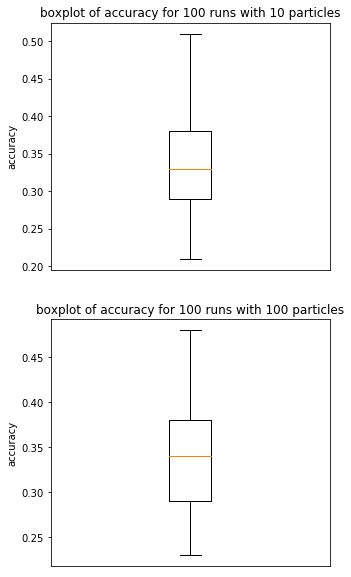

In [188]:
accuracies = run_particles(Sequential_IS,hmm,100,[10,100],verbose=1)

----- 100 runs of 10 particles -----
Step 100 done in 0.0977sec   
0.0975sec avg, 9.7538sec total


----- 100 runs of 100 particles -----
Step 100 done in 0.8334sec   
0.8268sec avg, 82.6759sec total




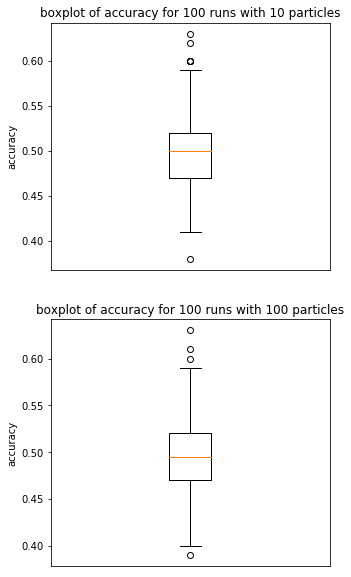

In [189]:
accuracies = run_particles(SIR,hmm,100,[10,100],verbose=1)

----- 100 runs of 10 particles -----
Step 100 done in 0.1010sec   
0.0973sec avg, 9.7349sec total


----- 100 runs of 100 particles -----
Step 100 done in 0.8208sec   
0.8281sec avg, 82.8128sec total




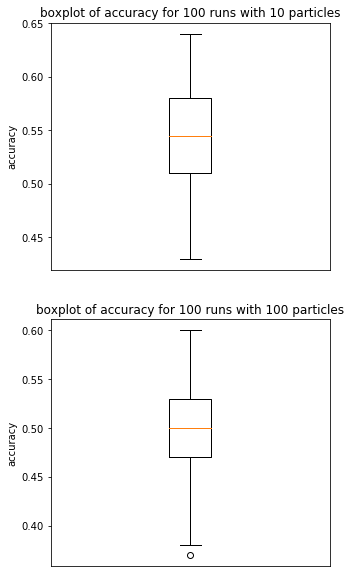

In [190]:
accuracies = run_particles(SIR_AR,hmm,100,[10,100],verbose=1)

In [224]:
accuracies

10   100
Nb_run id           
10     0    0.9  NaN
       1      1  NaN
       2   0.95  NaN
       3   0.95  NaN
       4   0.95  NaN
       5    0.7  NaN
       6    0.9  NaN
       7   0.95  NaN
       8      1  NaN
       9      1  NaN
100    0    NaN    1
       1    NaN    1
       2    NaN    1
       3    NaN    1
       4    NaN    1
       5    NaN    1
       6    NaN    1
       7    NaN    1
       8    NaN    1
       9    NaN    1
       10   NaN    1
       11   NaN    1
       12   NaN    1
       13   NaN    1
       14   NaN    1
       15   NaN    1
       16   NaN    1
       17   NaN    1
       18   NaN    1
       19   NaN    1
...         ...  ...
       70   NaN    1
       71   NaN    1
       72   NaN    1
       73   NaN    1
       74   NaN    1
       75   NaN    1
       76   NaN    1
       77   NaN    1
       78   NaN    1
       79   NaN    1
       80   NaN    1
       81   NaN    1
       82   NaN    1
       83   NaN    1
       84   NaN    1
       85   NaN    1
       86   NaN    1
       87   NaN    1
       88   NaN    1
       89   NaN    1
       90   NaN    1
       91   NaN    1
       92   NaN    1
       93   NaN    1
       94   NaN    1
       95   NaN    1
       96   NaN    1
       97   NaN    1
       98   NaN    1
       99   NaN    1

[110 rows x 2 columns]

----- 100 runs of 10 particles -----
Step 100 done in 0.2099sec   
0.2101sec avg, 21.0097sec total


----- 100 runs of 100 particles -----
Step 100 done in 2.0303sec   
2.0327sec avg, 203.2718sec total




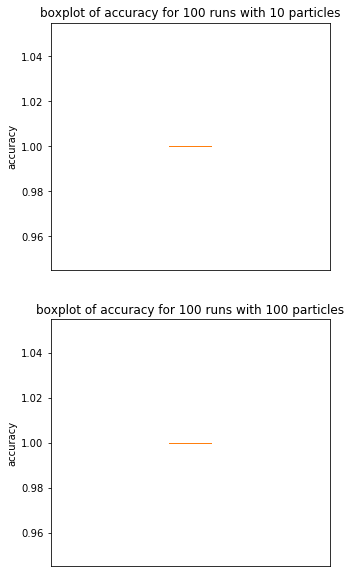

In [191]:
accuracies = run_particles(Sequential_IS,hmm,100,[10,100],importance_dist='opt',verbose=1)

----- 100 runs of 10 particles -----
Step 100 done in 0.2221sec   
0.2296sec avg, 22.9575sec total




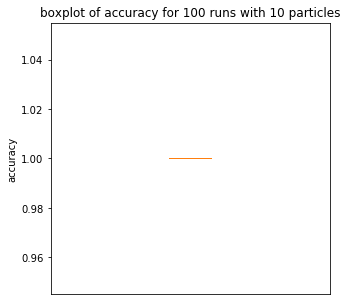

In [193]:
accuracies = run_particles(SIR,hmm,100,10,importance_dist='opt',verbose=1)

----- 100 runs of 10 particles -----
Step 100 done in 0.2126sec   
0.2108sec avg, 21.0849sec total




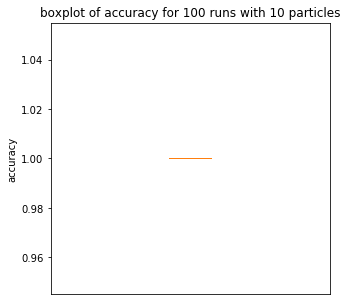

In [194]:
accuracies = run_particles(SIR_AR,hmm,100,10,importance_dist='opt',verbose=1)

## Bayesian HMM

In [6]:
def sample_init_bayes(dist, **params):
    if dist == 'discrete':
        assert 'Nb_states' in params and 'obs_params' in params and 'alpha' in params
        Nb_states = params['Nb_states']
        obs_params = params['obs_params']
        alpha = params['alpha']
        
        transition_mat = dirichlet.rvs(alpha=alpha,size=Nb_states)
        state_init = np.random.randint(Nb_states)
        obs_init = norm.rvs(**obs_params[state_init])
        
    elif dist == 'gaussian':
        pass
        
    return state_init, obs_init, transition_mat

def sample_next_bayes(current_state, dist, transition_mat, **params):
    if dist == 'discrete':
        assert 'Nb_states' in params and 'obs_params' in params
        Nb_states = params['Nb_states']
        obs_params = params['obs_params']
        
        next_state = np.random.choice(Nb_states,p=transition_mat[current_state])
        next_obs = norm.rvs(**obs_params[next_state])
        
    elif dist == 'gaussian':
        assert 'transition' in params and 'state_noise' in params and 'emission' in params and 'obs_noise' in params
        
        next_state = np.dot(params['transition'],current_state)+norm.rvs(**params['state_noise'])
        next_obs = np.dot(params['emission'],next_state)+norm.rvs(**params['obs_noise'])
        
    return next_state, next_obs

def generate_bayes(T,dist='discrete',**params):
    hmm = pd.DataFrame(np.zeros((T,2)),columns=['states','observations'])
    hmm['states'] = hmm['states'].astype(np.int64)
    state_init, obs_init, transition_mat = sample_init_bayes(dist,**params)
    hmm.iloc[0,:] = [state_init,obs_init]
    
    for t in np.arange(1,T):
        next_state, next_obs = sample_next_bayes(hmm['states'][t-1],dist,transition_mat,**params)
        hmm.iloc[t,:] = [next_state,next_obs]
        
    return hmm, transition_mat

In [82]:
params_discrete = {'Nb_states': 3, 'alpha': [10,5,8],
          'obs_params': {0:{'loc':0,'scale':1},1:{'loc':20,'scale':4},2:{'loc':100,'scale':10}}}

params = params_discrete
hmm, true_transition_mat = generate_bayes(100,dist='discrete',**params)
print(true_transition_mat)
hmm

[[ 0.52128922  0.17467623  0.30403455]
 [ 0.47938996  0.22066775  0.29994229]
 [ 0.36497791  0.10526405  0.52975804]]


,states,observations
0,1,23.552781
1,2,110.741870
2,2,96.024068
3,2,91.006794
4,2,85.779842
5,0,-0.313567
6,0,1.352621
7,2,111.191520
8,2,90.834628
9,2,108.099626


In [83]:
def init_naive(**args):
    init_particles = np.random.randint(args['Nb_states'],size=args['N'])
    init_w = [norm.pdf(args['obs'],**args['obs_params'][particle]) for particle in init_particles]
    return init_particles, init_w

def init_opt(**args):
    transition_prob = [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    init_w = np.repeat(np.sum(transition_prob),args['N'])
    transition_prob = transition_prob/np.sum(transition_prob)
    init_particles = [np.random.choice(args['Nb_states'],p=transition_prob) for _ in range(args['N'])]
    return init_particles, init_w

def next_step_naive(**args):
    particle = np.random.choice(args['Nb_states'],p=args['transition_mat'])
    w = args['weights'] * norm.pdf(args['obs'],**args['obs_params'][particle])
    return particle, w

def next_step_opt(**args):
    transition_prob = args['transition_mat'] * [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    w = args['weights'] * np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return particle, w

In [84]:
def compute_offsprings(W,N):
    weights_cumsum = np.hstack((0,np.cumsum(W)))
    offsprings = np.zeros(N,dtype=np.int64)
    U = uniform.rvs(scale=1./N)
    U_inc = 0
    for i in np.arange(1,N+1):
        while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
            offsprings[i-1] = offsprings[i-1] + 1
            U_inc = U_inc + 1./N
    return offsprings

def SIR(obs,N=10,estimator='hat',importance_dist='opt',plot=False,verbose=1,**params):
    if importance_dist == 'opt':
        init = init_opt
        next_step = next_step_opt
    elif importance_dist == 'naive':
        init = init_naive
        next_step = next_step_naive
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    v = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'alpha' in params and 'obs_params' in params
    Nb_states = params['Nb_states']
    alpha = params['alpha']
    obs_params = params['obs_params']
    S = np.zeros((N,Nb_states,Nb_states),dtype=np.int64)
    transition_mat = np.zeros((N,Nb_states,Nb_states),dtype=np.double)
    
    ### Initialization ###
    # Sample parameters
    for i in range(N):
        transition_mat[i,:,:] = dirichlet.rvs(alpha=alpha,size=Nb_states)
                
    particles[0,:], w[0,:] = init(Nb_states=Nb_states,N=N,obs=obs[0],obs_params=obs_params)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        
        # Resample particles (and weights)
        if verbose == 2:
            print('particles before offsprings',particles[k-1,:])
        ### compute weights 
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],**obs_params[state]) for state in range(Nb_states)]
            v[i] = np.sum(transition_prob)
        if np.sum(v) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k-1,:] = np.repeat(1./N,N)
        else:
            weights[k-1,:] = v/np.sum(v)
        ### compute offsprings
        offsprings = compute_offsprings(weights[k-1,:],N)
        new_particles_idx = np.repeat(range(N),offsprings)
        ### resample
        particles[0:(k-1),:] = particles[0:(k-1),new_particles_idx]
        S = S[new_particles_idx,:,:]
        transition_mat = transition_mat[new_particles_idx,:,:]
        weights[k-1,:] = np.repeat(1./N,N) # is this line correct ?
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after offsprings',particles[k-1,:])
        
        # Sample new particles
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],**obs_params[state]) for state in range(Nb_states)]
            transition_prob = transition_prob/np.sum(transition_prob)
            particles[k,i] = np.random.choice(Nb_states,p=transition_prob)    
            
            # Update sufficient statistics
            S[i,particles[k-1,i],particles[k,i]]+=1
            
        # Sample parameters
        for i in range(N):
            for j in range(Nb_states):
                transition_mat[i,j,:] = dirichlet.rvs(alpha=alpha+S[i,j,:])
              
        if verbose == 2:
            print('new particles ',particles[k,:])
        
    
    return particles, weights, transition_mat, S

Step 99 done in 0.0071sec   
0.0066sec avg, 0.6574sec total



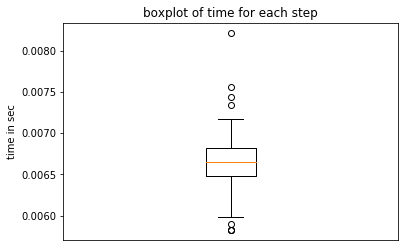

In [85]:
particles, weights, transition_mat, S = SIR(hmm['observations'].values,N=10,importance_dist='opt',plot=True,verbose=1,**params)

In [86]:
estimated_states = estimate_states(particles,weights)
accuracy(hmm['states'],estimated_states)

1.0

In [12]:
np.mean(transition_mat,axis=0)

array([[ 0.39316184,  0.14909096,  0.4577472 ],
       [ 0.40168227,  0.21840092,  0.37991681],
       [ 0.4494529 ,  0.16278738,  0.38775972]])

In [13]:
true_transition_mat

array([[ 0.45366774,  0.14847663,  0.39785563],
       [ 0.26863564,  0.20797764,  0.52338672],
       [ 0.46328113,  0.16095888,  0.37575999]])

## Bayesian HMM with Dirichlet prior on transitions and Gaussian prior on emissions

In [2]:
import pyhsmm
import pyhsmm.basic.distributions as distributions

In [45]:
def generate_data(priormodel,T=1000,draw=False):
    data = priormodel.generate(T=T)
    if draw:
        plt.figure(figsize=(15,5))
        plt.plot(data[0]);
    return data

In [46]:
gauss1 = {'mu_0': 0,'tausq_0': 1,'sigmasq':1}
gauss2 = {'mu_0': 20,'tausq_0': 1,'sigmasq':4}
gauss3 = {'mu_0': 100,'tausq_0': 4,'sigmasq':16}

### construct prior model
prior_HMM_Poisson = pyhsmm.models.HMM(
        init_state_distn='uniform',
        alpha=2.,
        obs_distns=[distributions.ScalarGaussianFixedvar(**gauss1), 
                    distributions.ScalarGaussianFixedvar(**gauss2),
                   distributions.ScalarGaussianFixedvar(**gauss3)])

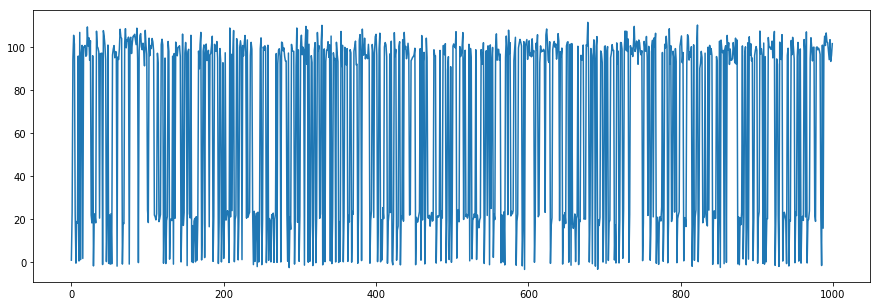

In [47]:
priormodel = prior_HMM_Poisson
T = 1000
data = generate_data(priormodel,T,draw=True)

In [11]:
data[1][:10]

array([1, 1, 1, 0, 2, 0, 0, 1, 0, 0], dtype=int32)

In [12]:
priormodel.obs_distns

[ScalarGaussianFixedvar(mu=0.336946,sigmasq=1.000000),
 ScalarGaussianFixedvar(mu=20.723524,sigmasq=4.000000),
 ScalarGaussianFixedvar(mu=96.940243,sigmasq=16.000000)]

In [13]:
priormodel.trans_distn.trans_matrix

array([[ 0.18784781,  0.06702216,  0.74513003],
       [ 0.53673766,  0.44057358,  0.02268876],
       [ 0.63436698,  0.25161561,  0.1140174 ]])

In [14]:
def init_naive(**args):
    init_particles = np.random.randint(args['Nb_states'],size=args['N'])
    init_w = [norm.pdf(args['obs'],**args['obs_params'][particle]) for particle in init_particles]
    return init_particles, init_w

def init_opt(**args):
    transition_prob = [norm.pdf(args['obs'],loc=args['theta'][state],scale=np.sqrt(args['sigmasq'][state])) for state in range(args['Nb_states'])]
    init_w = np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    init_particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return init_particle, init_w

def next_step_naive(**args):
    particle = np.random.choice(args['Nb_states'],p=args['transition_mat'])
    w = args['weights'] * norm.pdf(args['obs'],**args['obs_params'][particle])
    return particle, w

def next_step_opt(**args):
    transition_prob = args['transition_mat'] * [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    w = args['weights'] * np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return particle, w

In [15]:
def compute_offsprings(W,N):
    weights_cumsum = np.hstack((0,np.cumsum(W)))
    offsprings = np.zeros(N,dtype=np.int64)
    U = uniform.rvs(scale=1./N)
    U_inc = 0
    for i in np.arange(1,N+1):
        while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
            offsprings[i-1] = offsprings[i-1] + 1
            U_inc = U_inc + 1./N
    return offsprings

def SIR(obs,N=10,estimator='hat',importance_dist='opt',plot=False,verbose=1,**params):
    if importance_dist == 'opt':
        init = init_opt
        next_step = next_step_opt
    elif importance_dist == 'naive':
        init = init_naive
        next_step = next_step_naive
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    v = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'alpha' in params
    assert 'mu_0' in params and 'tausq_0' in params and 'sigmasq' in params
    Nb_states = params['Nb_states']
    alpha = params['alpha']
    mu_0 = params['mu_0']
    tausq_0 = params['tausq_0']
    sigmasq = params['sigmasq']
    mu_n = np.array([mu_0 for _ in range(N)])
    tausq_n = np.array([tausq_0 for _ in range(N)])
    #obs_params = {state:{'scale':sigmasq[state]} for state in range(Nb_states)}
    transition_counts = np.zeros((N,Nb_states,Nb_states),dtype=np.int64)
    transition_mat = np.zeros((N,Nb_states,Nb_states),dtype=np.double)
    obs_sum = np.zeros((N,Nb_states),dtype=np.double)
    Nb_obs = np.zeros((N,Nb_states),dtype=np.int64)
    theta = np.zeros((N,Nb_states),dtype=np.double) 
    
    ### Initialization ###
    # Sample parameters
    for i in range(N):
        transition_mat[i,:,:] = dirichlet.rvs(alpha=alpha,size=Nb_states)
        theta[i,:] = [norm.rvs(loc=mu_0[state],scale=np.sqrt(tausq_0[state])) for state in range(Nb_states)]
                
        particles[0,i], w[0,i] = init(Nb_states=Nb_states,obs=obs[0],theta=theta[i,:],sigmasq=sigmasq)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        
        # Resample particles (and weights)
        if verbose == 2:
            print('particles before resampling',particles[k-1,:])
            print('theta before resampling',theta)
        ### compute weights 
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            v[i] = np.sum(transition_prob)
        if np.sum(v) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k-1,:] = np.repeat(1./N,N)
        else:
            weights[k-1,:] = v/np.sum(v)
        ### compute offsprings
        offsprings = compute_offsprings(weights[k-1,:],N)
        new_particles_idx = np.repeat(range(N),offsprings)
        ### resample
        particles[0:(k-1),:] = particles[0:(k-1),new_particles_idx]
        transition_counts = transition_counts[new_particles_idx,:,:]
        transition_mat = transition_mat[new_particles_idx,:,:]
        obs_sum = obs_sum[new_particles_idx,:]
        theta = theta[new_particles_idx,:]
        weights[k-1,:] = np.repeat(1./N,N) # is this line correct ?
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after resampling',particles[k-1,:])
            print('theta after resampling',theta)
        
        # Sample new particles
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            transition_prob = transition_prob/np.sum(transition_prob)
            particles[k,i] = np.random.choice(Nb_states,p=transition_prob)    
            
            # Update sufficient statistics
            transition_counts[i,particles[k-1,i],particles[k,i]]+=1
            obs_sum[i,particles[k,i]]+=obs[k]
            Nb_obs[i,particles[k,i]]+=1
            
        # Sample parameters
        for i in range(N):
            tausq_n[i,particles[k,i]] = 1./(1./tausq_0[particles[k,i]] + Nb_obs[i,particles[k,i]]/sigmasq[particles[k,i]])
            mu_n[i,particles[k,i]] = (mu_0[particles[k,i]]/tausq_0[particles[k,i]] + obs_sum[i,particles[k,i]]/sigmasq[particles[k,i]])*tausq_n[i,particles[k,i]]
            theta[i,:] = [norm.rvs(loc=mu_n[i,state],scale=np.sqrt(tausq_n[i,state])) for state in range(Nb_states)]
            for j in range(Nb_states):
                transition_mat[i,j,:] = dirichlet.rvs(alpha=alpha+transition_counts[i,j,:])
              
        if verbose == 2:
            print('new particles ',particles[k,:])
            print('tausq_n',tausq_n)
            print('mu_n',mu_n)
            print('new theta ', theta)
        
    
    return particles, weights, transition_mat, transition_counts, theta, mu_n

Step 999 done in 0.0680sec   
0.0684sec avg, 68.3193sec total



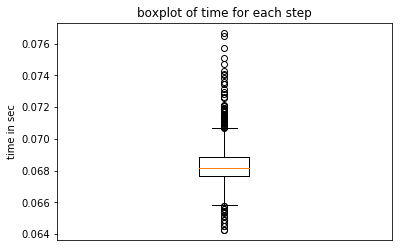

In [16]:
params = {'Nb_states': 3, 'alpha': [1./3.,1./3.,1./3.],
         'mu_0':[0.,20.,100.],'tausq_0':[1.,1.,4.],'sigmasq':[1.,4.,16.]}
particles, weights, transition_mat, S, theta, mu_n = SIR(data[0],N=100,importance_dist='opt',plot=True,verbose=1,**params)

In [17]:
estimated_states = estimate_states(particles,weights)
accuracy(data[1],estimated_states)

1.0

In [18]:
np.mean(transition_mat,axis=0)

array([[ 0.18880903,  0.07917918,  0.73201179],
       [ 0.55214896,  0.4110214 ,  0.03682964],
       [ 0.62383432,  0.27788028,  0.0982854 ]])

In [19]:
priormodel.trans_distn.trans_matrix

array([[ 0.18784781,  0.06702216,  0.74513003],
       [ 0.53673766,  0.44057358,  0.02268876],
       [ 0.63436698,  0.25161561,  0.1140174 ]])

In [20]:
np.mean(theta,axis=0)

array([  0.43029615,  20.7573812 ,  97.12087705])

In [21]:
priormodel.obs_distns

[ScalarGaussianFixedvar(mu=0.336946,sigmasq=1.000000),
 ScalarGaussianFixedvar(mu=20.723524,sigmasq=4.000000),
 ScalarGaussianFixedvar(mu=96.940243,sigmasq=16.000000)]

### Here we change the weights to solve the fact that we have only 0. weights at the end

In [89]:
def compute_offsprings(W,N):
    weights_cumsum = np.hstack((0,np.cumsum(W)))
    offsprings = np.zeros(N,dtype=np.int64)
    U = uniform.rvs(scale=1./N)
    U_inc = 0
    for i in np.arange(1,N+1):
        while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
            offsprings[i-1] = offsprings[i-1] + 1
            U_inc = U_inc + 1./N
    return offsprings

def SIR(obs,N=10,estimator='hat',importance_dist='opt',plot=False,verbose=1,**params):
    if importance_dist == 'opt':
        init = init_opt
        next_step = next_step_opt
    elif importance_dist == 'naive':
        init = init_naive
        next_step = next_step_naive
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    v = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'alpha' in params
    assert 'mu_0' in params and 'tausq_0' in params and 'sigmasq' in params
    Nb_states = params['Nb_states']
    alpha = params['alpha']
    mu_0 = params['mu_0']
    tausq_0 = params['tausq_0']
    sigmasq = params['sigmasq']
    mu_n = np.zeros((N,Nb_states),dtype=np.double)
    tausq_n = np.zeros((N,Nb_states),dtype=np.double)
    #obs_params = {state:{'scale':sigmasq[state]} for state in range(Nb_states)}
    transition_counts = np.zeros((N,Nb_states,Nb_states),dtype=np.int64)
    transition_mat = np.zeros((N,Nb_states,Nb_states),dtype=np.double)
    obs_sum = np.zeros((N,Nb_states),dtype=np.double)
    theta = np.zeros((N,Nb_states),dtype=np.double) 
    
    ### Initialization ###
    # Sample parameters
    for i in range(N):
        transition_mat[i,:,:] = dirichlet.rvs(alpha=alpha,size=Nb_states)
        theta[i,:] = [norm.rvs(loc=mu_0[state],scale=np.sqrt(tausq_0[state])) for state in range(Nb_states)]
                
        particles[0,i], w[0,i] = init(Nb_states=Nb_states,obs=obs[0],theta=theta[i,:],sigmasq=sigmasq)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        
        # Resample particles (and weights)
        if verbose == 2:
            print('particles before offsprings',particles[k-1,:])
        ### compute weights 
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            v[i] = np.sum(transition_prob)
        if np.sum(v) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k,:] = np.repeat(1./N,N)
        else:
            weights[k,:] = v/np.sum(v)
        ### compute offsprings
        offsprings = compute_offsprings(weights[k,:],N)
        new_particles_idx = np.repeat(range(N),offsprings)
        ### resample
        particles[0:(k-1),:] = particles[0:(k-1),new_particles_idx]
        transition_counts = transition_counts[new_particles_idx,:,:]
        transition_mat = transition_mat[new_particles_idx,:,:]
        obs_sum = obs_sum[new_particles_idx,:]
        theta = theta[new_particles_idx,:]
        weights[k-1,:] = np.repeat(1./N,N) # is this line correct ?
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after offsprings',particles[k-1,:])
        
        # Sample new particles
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            transition_prob = transition_prob/np.sum(transition_prob)
            particles[k,i] = np.random.choice(Nb_states,p=transition_prob)    
            
            # Update sufficient statistics
            transition_counts[i,particles[k-1,i],particles[k,i]]+=1
            obs_sum[i,particles[k,i]]+=obs[k]
            
        # Sample parameters
        for i in range(N):
            tausq_n[i,particles[k,i]] = 1./(1./tausq_0[particles[k,i]] + k/sigmasq[particles[k,i]])
            mu_n[i,particles[k,i]] = (mu_0[particles[k,i]]/tausq_0[particles[k,i]] + obs_sum[i,particles[k,i]]/sigmasq[particles[k,i]])*tausq_n[i,particles[k,i]]
            theta[i,:] = [norm.rvs(loc=mu_n[i,state],scale=np.sqrt(tausq_n[i,state])) for state in range(Nb_states)]
            for j in range(Nb_states):
                transition_mat[i,j,:] = dirichlet.rvs(alpha=alpha+transition_counts[i,j,:])
              
        if verbose == 2:
            print('new particles ',particles[k,:])
        
    
    return particles, weights, transition_mat, transition_counts, theta, mu_n

Step 999 done in 0.0078sec   
0.0079sec avg, 7.9328sec total



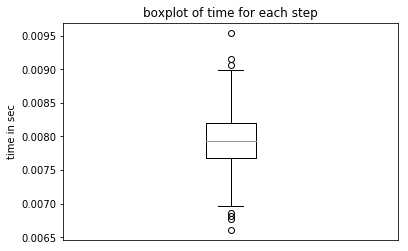

In [90]:
params = {'Nb_states': 3, 'alpha': [1./3.,1./3.,1./3.],
         'mu_0':[0,20,100],'tausq_0':[1,1,4],'sigmasq':[1,4,16]}
particles, weights, transition_mat, S, theta, mu_n = SIR(data[0],N=10,importance_dist='opt',plot=True,verbose=1,**params)

In [91]:
estimated_states = estimate_states(particles,weights)
accuracy(data[1],estimated_states)

0.58699999999999997

## Bayesian HSMM

In [4]:
import pyhsmm
import pyhsmm.basic.distributions as distributions

In [5]:
def generate_data(priormodel,T=1000,draw=False):
    data = priormodel.generate(T=T)
    if draw:
        plt.figure(figsize=(15,5))
        plt.plot(data[0]);
    return data

In [6]:
gauss1 = {'mu_0': 0,'tausq_0': 1,'sigmasq':1}
gauss2 = {'mu_0': 20,'tausq_0': 1,'sigmasq':4}
gauss3 = {'mu_0': 100,'tausq_0': 4,'sigmasq':16}
Poisson1 = {'alpha_0': 3, 'beta_0': 1}
Poisson2 = {'alpha_0': 10, 'beta_0': 2}
Poisson3 = {'alpha_0': 50, 'beta_0': 5}

### construct prior model
prior_HSMM_Poisson = pyhsmm.models.HSMM(
        init_state_distn='uniform',
        alpha=3.,
        obs_distns=[distributions.ScalarGaussianFixedvar(**gauss1), 
                    distributions.ScalarGaussianFixedvar(**gauss2),
                   distributions.ScalarGaussianFixedvar(**gauss3)],
        dur_distns=[distributions.PoissonDuration(**Poisson1),
                    distributions.PoissonDuration(**Poisson2),
                    distributions.PoissonDuration(**Poisson3)])

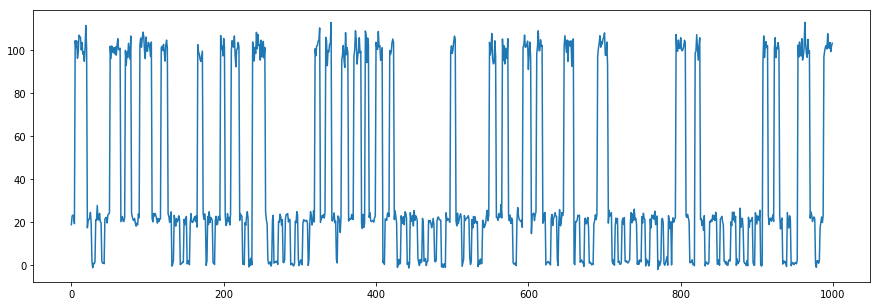

In [7]:
priormodel = prior_HSMM_Poisson
T = 1000
data = generate_data(priormodel,T,draw=True)

In [11]:
data[1][:10]

array([1, 1, 1, 1, 1, 2, 2, 2, 2, 2], dtype=int32)

In [12]:
priormodel.obs_distns

[ScalarGaussianFixedvar(mu=2.063090,sigmasq=1.000000),
 ScalarGaussianFixedvar(mu=22.048200,sigmasq=4.000000),
 ScalarGaussianFixedvar(mu=99.539492,sigmasq=16.000000)]

In [13]:
[priormodel.dur_distns[i].lmbda for i in range(3)]

[6.414487288549389, 4.309800949126002, 10.570655259125234]

In [14]:
priormodel.trans_distn.trans_matrix

array([[ 0.        ,  0.70584106,  0.29415894],
       [ 0.62298637,  0.        ,  0.37701363],
       [ 0.70884129,  0.29115871,  0.        ]])

In [15]:
def init(**args):
    transition_prob = [norm.pdf(args['obs'],loc=args['theta'][state],scale=np.sqrt(args['sigmasq'][state])) for state in range(args['Nb_states'])]
    init_w = np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    init_particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return init_particle, init_w

def next_step(**args):
    transition_prob = args['transition_mat'] * [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    w = args['weights'] * np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return particle, w

In [16]:
def compute_offsprings(W,N):
    weights_cumsum = np.hstack((0,np.cumsum(W)))
    offsprings = np.zeros(N,dtype=np.int64)
    U = uniform.rvs(scale=1./N)
    U_inc = 0
    for i in np.arange(1,N+1):
        while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
            offsprings[i-1] = offsprings[i-1] + 1
            U_inc = U_inc + 1./N
    return offsprings

def SIR_HSMM(obs,N=10,estimator='hat',plot=False,verbose=1,**params):
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    v = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'alpha' in params
    assert 'mu_0' in params and 'tausq_0' in params and 'sigmasq' in params
    Nb_states = params['Nb_states']
    alpha = params['alpha']
    mu_0 = params['mu_0']
    tausq_0 = params['tausq_0']
    sigmasq = params['sigmasq']
    mu_n = np.array([mu_0 for _ in range(N)])
    tausq_n = np.array([tausq_0 for _ in range(N)])
    #obs_params = {state:{'scale':sigmasq[state]} for state in range(Nb_states)}
    transition_counts = np.zeros((N,Nb_states,Nb_states),dtype=np.int64)
    transition_mat = np.zeros((N,Nb_states,Nb_states),dtype=np.double)
    obs_sum = np.zeros((N,Nb_states),dtype=np.double)
    Nb_obs = np.zeros((N,Nb_states),dtype=np.int64)
    theta = np.zeros((N,Nb_states),dtype=np.double) 
    
    ### Initialization ###
    # Sample parameters
    for i in range(N):
        transition_mat[i,:,:] = dirichlet.rvs(alpha=alpha,size=Nb_states)
        theta[i,:] = [norm.rvs(loc=mu_0[state],scale=np.sqrt(tausq_0[state])) for state in range(Nb_states)]
                
        particles[0,i], w[0,i] = init(Nb_states=Nb_states,obs=obs[0],theta=theta[i,:],sigmasq=sigmasq)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        
        # Resample particles (and weights)
        if verbose == 2:
            print('particles before resampling',particles[k-1,:])
            print('theta before resampling',theta)
        ### compute weights 
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            v[i] = np.sum(transition_prob)
        if np.sum(v) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k-1,:] = np.repeat(1./N,N)
        else:
            weights[k-1,:] = v/np.sum(v)
        ### compute offsprings
        offsprings = compute_offsprings(weights[k-1,:],N)
        new_particles_idx = np.repeat(range(N),offsprings)
        ### resample
        particles[0:(k-1),:] = particles[0:(k-1),new_particles_idx]
        transition_counts = transition_counts[new_particles_idx,:,:]
        transition_mat = transition_mat[new_particles_idx,:,:]
        obs_sum = obs_sum[new_particles_idx,:]
        theta = theta[new_particles_idx,:]
        weights[k-1,:] = np.repeat(1./N,N) # is this line correct ?
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after resampling',particles[k-1,:])
            print('theta after resampling',theta)
        
        # Sample new particles
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            transition_prob = transition_prob/np.sum(transition_prob)
            particles[k,i] = np.random.choice(Nb_states,p=transition_prob)    
            
            # Update sufficient statistics
            transition_counts[i,particles[k-1,i],particles[k,i]]+=1
            obs_sum[i,particles[k,i]]+=obs[k]
            Nb_obs[i,particles[k,i]]+=1
            
        # Sample parameters
        for i in range(N):
            tausq_n[i,particles[k,i]] = 1./(1./tausq_0[particles[k,i]] + Nb_obs[i,particles[k,i]]/sigmasq[particles[k,i]])
            mu_n[i,particles[k,i]] = (mu_0[particles[k,i]]/tausq_0[particles[k,i]] + obs_sum[i,particles[k,i]]/sigmasq[particles[k,i]])*tausq_n[i,particles[k,i]]
            theta[i,:] = [norm.rvs(loc=mu_n[i,state],scale=np.sqrt(tausq_n[i,state])) for state in range(Nb_states)]
            for j in range(Nb_states):
                transition_mat[i,j,:] = dirichlet.rvs(alpha=alpha+transition_counts[i,j,:])
              
        if verbose == 2:
            print('new particles ',particles[k,:])
            print('tausq_n',tausq_n)
            print('mu_n',mu_n)
            print('new theta ', theta)
        
    
    return particles, weights, transition_mat, transition_counts, theta, mu_n

Step 999 done in 0.0083sec   
0.0081sec avg, 8.1162sec total



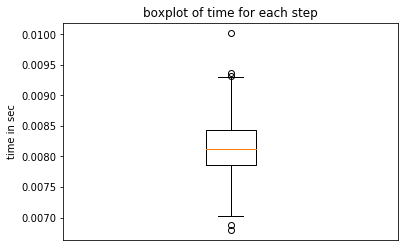

In [18]:
params = {'Nb_states': 3, 'alpha': [1./3.,1./3.,1./3.],
         'mu_0':[0.,20.,100.],'tausq_0':[1.,1.,4.],'sigmasq':[1.,4.,16.]}
particles, weights, transition_mat, S, theta, mu_n = SIR_HSMM(data[0],N=10,plot=True,verbose=1,**params)

In [19]:
estimated_states = estimate_states(particles,weights)
accuracy(data[1],estimated_states)

1.0

In [20]:
np.mean(theta,axis=0)

array([  1.99322965,  22.02768481,  99.59328771])

In [21]:
priormodel.obs_distns

[ScalarGaussianFixedvar(mu=2.063090,sigmasq=1.000000),
 ScalarGaussianFixedvar(mu=22.048200,sigmasq=4.000000),
 ScalarGaussianFixedvar(mu=99.539492,sigmasq=16.000000)]

In [22]:
[priormodel.dur_distns[i].lmbda for i in range(3)]

[6.414487288549389, 4.309800949126002, 10.570655259125234]

In [23]:
np.mean(transition_mat,axis=0)

array([[ 0.85760157,  0.09064141,  0.05175702],
       [ 0.12020516,  0.81558424,  0.0642106 ],
       [ 0.06042935,  0.02684351,  0.91272714]])

In [24]:
priormodel.trans_distn.trans_matrix

array([[ 0.        ,  0.70584106,  0.29415894],
       [ 0.62298637,  0.        ,  0.37701363],
       [ 0.70884129,  0.29115871,  0.        ]])

# Test on real data

In [3]:
import sqlite3

In [14]:
house_id = 490
device = 'air'

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()

# we get all the columns (non equal to 0) associated with the device
alldevices = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
# we stock the data for these columns and we change the unit to Watts
powers = data.loc[:,alldevices]*1000

In [15]:
powers.shape

(44641, 1)

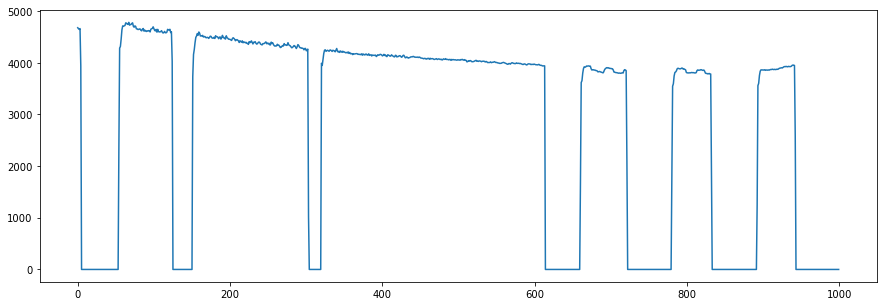

In [16]:
plt.figure(figsize=(15,5))
T = 1000
true_values = powers.iloc[T:(T+1000),:].values.T[0]
plt.plot(true_values);

In [40]:
import pickle
dict_file = open( "priors.dict", "rb" )
priors_hyperparams = pickle.load( dict_file, encoding='latin1' )
dict_file.close()

In [41]:
priors_hyperparams['air']

{'mode 0': {'Dur nbinom': {'alpha_0': 61.094864938503548,
   'beta_0': 0.78810214499156406,
   'r': 0.39304789459932488},
  'Obs gaussian': {'mu_0': 0.27966257724320603,
   'sigmasq': 2.8152545731663734,
   'tausq_0': 0.21245470220140811}},
 'mode 1': {'Dur nbinom': {'alpha_0': 34.860864953232685,
   'beta_0': 0.60901681331831647,
   'r': 0.34781851034629463},
  'Obs gaussian': {'mu_0': 2483.4324388717696,
   'sigmasq': 58137.155801451379,
   'tausq_0': 694637.28162369051}}}

In [42]:
obs_mu = [priors_hyperparams['air']['mode 0']['Obs gaussian']['mu_0'],
          priors_hyperparams['air']['mode 1']['Obs gaussian']['mu_0']]
obs_sigmasq = [priors_hyperparams['air']['mode 0']['Obs gaussian']['sigmasq'],
          priors_hyperparams['air']['mode 1']['Obs gaussian']['sigmasq']]
obs_tausq = [priors_hyperparams['air']['mode 0']['Obs gaussian']['tausq_0'],
          priors_hyperparams['air']['mode 1']['Obs gaussian']['tausq_0']]

In [111]:
def init(**args):
    transition_prob = [norm.pdf(args['obs'],loc=args['theta'][state],scale=np.sqrt(args['sigmasq'][state])) for state in range(args['Nb_states'])]
    init_w = np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    init_particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return init_particle, init_w

def next_step(**args):
    transition_prob = args['transition_mat'] * [norm.pdf(args['obs'],**args['obs_params'][state]) for state in range(args['Nb_states'])]
    w = args['weights'] * np.sum(transition_prob)
    transition_prob = transition_prob/np.sum(transition_prob)
    particle = np.random.choice(args['Nb_states'],p=transition_prob)
    return particle, w

In [112]:
def compute_offsprings(W,N):
    weights_cumsum = np.hstack((0,np.cumsum(W)))
    offsprings = np.zeros(N,dtype=np.int64)
    U = uniform.rvs(scale=1./N)
    U_inc = 0
    for i in np.arange(1,N+1):
        while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
            offsprings[i-1] = offsprings[i-1] + 1
            U_inc = U_inc + 1./N
    return offsprings

def SIR_HSMM(obs,N=10,estimator='hat',plot=False,verbose=1,**params):
    n = len(obs)
    if plot and verbose == 0:
        verbose = 1
    if verbose == 1 or verbose == 2:
        iterator = timeprint(np.arange(1,n),plot)
    else:
        iterator = np.arange(1,n)
    particles = np.zeros((n,N),dtype=np.int64)
    w = np.zeros((n,N),dtype=np.double)
    weights = np.zeros((n,N),dtype=np.double)
    U = np.zeros(N,dtype=np.double)
    v = np.zeros(N,dtype=np.double)
    assert 'Nb_states' in params and 'alpha' in params
    assert 'mu_0' in params and 'tausq_0' in params and 'sigmasq' in params
    Nb_states = params['Nb_states']
    alpha = params['alpha']
    mu_0 = params['mu_0']
    tausq_0 = params['tausq_0']
    sigmasq = params['sigmasq']
    mu_n = np.array([mu_0 for _ in range(N)])
    tausq_n = np.array([tausq_0 for _ in range(N)])
    #obs_params = {state:{'scale':sigmasq[state]} for state in range(Nb_states)}
    transition_counts = np.zeros((N,Nb_states,Nb_states),dtype=np.int64)
    transition_mat = np.zeros((N,Nb_states,Nb_states),dtype=np.double)
    obs_sum = np.zeros((N,Nb_states),dtype=np.double)
    Nb_obs = np.zeros((N,Nb_states),dtype=np.int64)
    theta = np.zeros((N,Nb_states),dtype=np.double) 
    
    ### Initialization ###
    # Sample parameters
    for i in range(N):
        transition_mat[i,:,:] = dirichlet.rvs(alpha=alpha,size=Nb_states)
        theta[i,:] = [norm.rvs(loc=mu_0[state],scale=np.sqrt(tausq_0[state])) for state in range(Nb_states)]
                
        particles[0,i], w[0,i] = init(Nb_states=Nb_states,obs=obs[0],theta=theta[i,:],sigmasq=sigmasq)
    weights[0,:] = w[0,:]/np.sum(w[0,:])
    
    ### Iterations ###
    for k in iterator:
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(k))
        
        # Resample particles (and weights)
        if verbose == 2:
            print('particles before resampling',particles[k-1,:])
            print('theta before resampling',theta)
        ### compute weights 
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            v[i] = np.sum(transition_prob)
        if np.sum(v) == 0.:
            # case when all particles are unlikely (we put uniform weights on all particles)
            weights[k-1,:] = np.repeat(1./N,N)
        else:
            weights[k-1,:] = v/np.sum(v)
        ### compute offsprings
        offsprings = compute_offsprings(weights[k-1,:],N)
        new_particles_idx = np.repeat(range(N),offsprings)
        ### resample
        particles[0:(k-1),:] = particles[0:(k-1),new_particles_idx]
        transition_counts = transition_counts[new_particles_idx,:,:]
        transition_mat = transition_mat[new_particles_idx,:,:]
        obs_sum = obs_sum[new_particles_idx,:]
        theta = theta[new_particles_idx,:]
        weights[k-1,:] = np.repeat(1./N,N) # is this line correct ?
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after resampling',particles[k-1,:])
            print('theta after resampling',theta)
        
        # Sample new particles
        for i in range(N):
            transition_prob = transition_mat[i,particles[k-1,i],:] * [norm.pdf(obs[k],loc=theta[i,state],scale=np.sqrt(sigmasq[state])) for state in range(Nb_states)]
            transition_prob = transition_prob/np.sum(transition_prob)
            particles[k,i] = np.random.choice(Nb_states,p=transition_prob)    
            
            # Update sufficient statistics
            transition_counts[i,particles[k-1,i],particles[k,i]]+=1
            obs_sum[i,particles[k,i]]+=obs[k]
            Nb_obs[i,particles[k,i]]+=1
            
        # Sample parameters
        for i in range(N):
            tausq_n[i,particles[k,i]] = 1./(1./tausq_0[particles[k,i]] + Nb_obs[i,particles[k,i]]/sigmasq[particles[k,i]])
            mu_n[i,particles[k,i]] = (mu_0[particles[k,i]]/tausq_0[particles[k,i]] + obs_sum[i,particles[k,i]]/sigmasq[particles[k,i]])*tausq_n[i,particles[k,i]]
            theta[i,:] = [norm.rvs(loc=mu_n[i,state],scale=np.sqrt(tausq_n[i,state])) for state in range(Nb_states)]
            for j in range(Nb_states):
                transition_mat[i,j,:] = dirichlet.rvs(alpha=alpha+transition_counts[i,j,:])
              
        if verbose == 2:
            print('new particles ',particles[k,:])
            print('tausq_n',tausq_n)
            print('mu_n',mu_n)
            print('new theta ', theta)
        
    
    return particles, weights, transition_mat, transition_counts, theta, mu_n

Step 999 done in 0.0053sec   
0.0059sec avg, 5.8775sec total



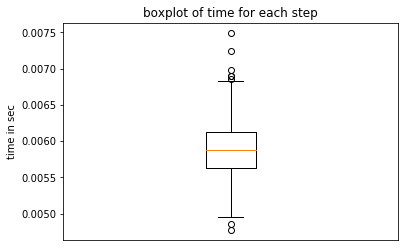

In [152]:
L = 1
params = {'Nb_states': 2*L, 'alpha': np.repeat(1./(2*L),2*L),
         'mu_0':np.repeat(obs_mu,L),'tausq_0':np.repeat(obs_tausq,L),'sigmasq':np.repeat(obs_sigmasq,L)}
particles, weights, transition_mat, S, theta, mu_n = SIR_HSMM(true_values,N=10,plot=True,verbose=1,**params)

In [153]:
estimated_states = estimate_states(particles,weights)

In [154]:
estimated_mu = np.mean(theta,axis=0)
estimated_mu

array([  1.92521847e-02,   4.13275837e+03])

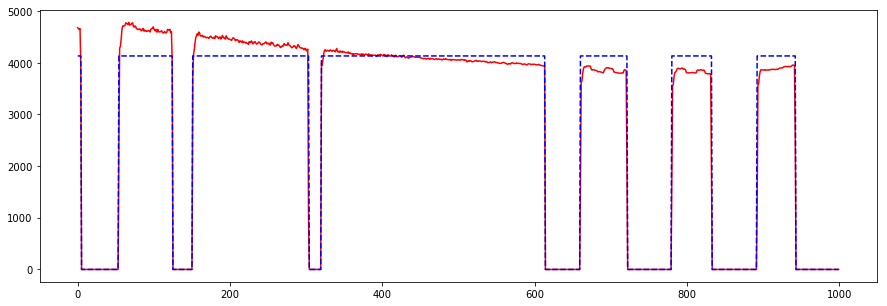

In [156]:
estimated_power = estimated_mu[estimated_states]
#estimated_power
plt.figure(figsize=(15,5))
plt.plot(true_values,color='red')
plt.plot(estimated_power,linestyle='--',color='blue');

Step 999 done in 0.1292sec   
0.1282sec avg, 128.0947sec total



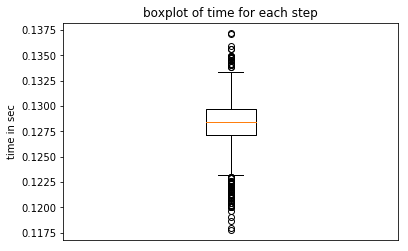

In [137]:
L = 3
params = {'Nb_states': 2*L, 'alpha': np.repeat(1./(2*L),2*L),
         'mu_0':np.repeat(obs_mu,L),'tausq_0':np.repeat(obs_tausq,L),'sigmasq':np.repeat(obs_sigmasq,L)}
particles, weights, transition_mat, S, theta, mu_n = SIR_HSMM(data.T[0],N=100,plot=True,verbose=1,**params)

In [138]:
estimated_states = estimate_states(particles,weights)

In [139]:
estimated_mu = np.mean(theta,axis=0)
estimated_mu

array([  1.55383324e-01,   1.12149139e-02,   9.56957424e-02,
         1.40609155e+03,   4.21135399e+03,   2.45937818e+03])

In [143]:
estimated_power = estimated_mu[estimated_states]
#print(estimated_power)
print('Mean absolute error: {}'.format(np.sum(np.abs(data.T[0] - estimated_power))/T))

Mean absolute error: 162.74100868792982


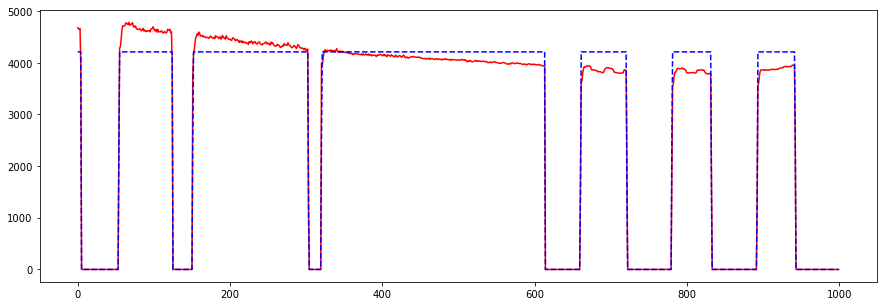

In [140]:
plt.figure(figsize=(15,5))
plt.plot(data,color='red')
plt.plot(estimated_power,linestyle='--',color='blue');

In [15]:
import pickle
dict_file = open( "priors_precise.dict", "rb" )
priors_hyperparams = pickle.load( dict_file, encoding='latin1' )
dict_file.close()

In [5]:
priors_hyperparams

{'air': {'mode 0': {'Dur poisson': {'alpha_0': 2.2314033039349068,
    'beta_0': 0.043810788795085417},
   'Obs gaussian': {'mu_0': 0.074482144113356394,
    'sigmasq': 3.100597952872683,
    'tausq_0': 0.0008356626168000064}},
  'mode 1': {'Dur poisson': {'alpha_0': 1.4070736725053843,
    'beta_0': 0.035497887698959084},
   'Obs gaussian': {'mu_0': 3912.1674221440044,
    'sigmasq': 117429.43954645477,
    'tausq_0': 25902.79227497441}}},
 'refrigerator': {'mode 0': {'Dur poisson': {'alpha_0': 3.5949160061487642,
    'beta_0': 0.049495209792045886},
   'Obs gaussian': {'mu_0': 2.1551226715538574,
    'sigmasq': 23.900453681703276,
    'tausq_0': 3.3370875472157127}},
  'mode 1': {'Dur poisson': {'alpha_0': 22.424224859264712,
    'beta_0': 0.33891957552118374},
   'Obs gaussian': {'mu_0': 124.18557189690534,
    'sigmasq': 164.76495974934156,
    'tausq_0': 243.28831648825161}},
  'mode 2': {'Dur poisson': {'alpha_0': 5414.1113423516927,
    'beta_0': 242.10405827263156},
   'Obs gau

In [6]:
obs_mu = {}
obs_sigmasq = {}
obs_tausq = {}
Nb_states = {}

for key_device, device in priors_hyperparams.items():
    obs_mu[key_device] = [priors_hyperparams[key_device][mode]['Obs gaussian']['mu_0'] for mode in device.keys()]
    obs_sigmasq[key_device] = [priors_hyperparams[key_device][mode]['Obs gaussian']['sigmasq'] for mode in device.keys()]
    obs_tausq[key_device] = [priors_hyperparams[key_device][mode]['Obs gaussian']['tausq_0'] for mode in device.keys()]
    Nb_states[key_device] = len(device)

In [11]:
Nb_states

{'air': 2, 'dishwasher': 3, 'furnace': 2, 'refrigerator': 3}

In [7]:
import sqlite3

In [12]:
house_id = 490
device = 'refrigerator'

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()

# we get all the columns (non equal to 0) associated with the device
alldevices = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
# we stock the data for these columns and we change the unit to Watts
powers = data.loc[:,alldevices]*1000

refrigerator
Step 44640 done in 0.0151sec   
0.0142sec avg, 634.3523sec total



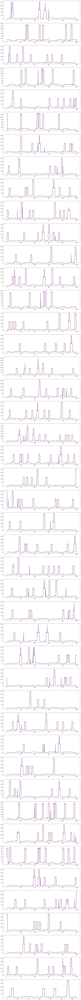

In [190]:
L = 2
print(device)
params = {'Nb_states': Nb_states[device]*L, 'alpha': np.repeat(1./(Nb_states[device]*L),Nb_states[device]*L),
         'mu_0':np.repeat(obs_mu[device],L),'tausq_0':np.repeat(obs_tausq[device],L),'sigmasq':np.repeat(obs_sigmasq[device],L)}

# load data
true_values = powers.values.T[0]
Nb_obs = len(true_values)

# compute particles filtering
particles, weights, transition_mat, S, theta, mu_n = SIR_HSMM(true_values,N=10,verbose=1,**params)

# estimate powers
estimated_states = estimate_states(particles,weights)
estimated_mu = np.mean(theta,axis=0)
estimated_power = estimated_mu[estimated_states]

# plot results
nb_plots = (Nb_obs // 1000) + 1
fig, axes = plt.subplots(nb_plots,1,figsize=(17,5*nb_plots))

for t in np.arange(0,nb_plots*1000,1000):
    axes[t//1000].plot(true_values[t:(t+1000)],color='red')
    axes[t//1000].plot(estimated_power[t:(t+1000)],linestyle='--',color='blue');

## Factorial Bayesian HMM

In [32]:
X = np.empty(2,dtype=object)
X[0] = np.tile([1,2,3],3).reshape(3,3)
X[1] = np.tile([4,5,6,7],3).reshape(3,4)

X[0][1,:]*=2

X

array([array([[1, 2, 3],
       [2, 4, 6],
       [1, 2, 3]]),
       array([[4, 5, 6, 7],
       [4, 5, 6, 7],
       [4, 5, 6, 7]])], dtype=object)

In [100]:
[X[i] for i in range(2)]

[array([[1, 2, 3],
        [2, 4, 6],
        [1, 2, 3]]), array([[4, 5, 6, 7],
        [4, 5, 6, 7],
        [4, 5, 6, 7]])]

In [51]:
pas=np.array([0,1])
np.sum([X[j][1,pas[j]] for j in range(2)])

7

In [74]:
Y = np.hstack((X[0],X[1][:3,:3])).reshape(2,3,3)
Y

array([[[1, 2, 3],
        [4, 5, 6],
        [2, 4, 6]],

       [[4, 5, 6],
        [1, 2, 3],
        [4, 5, 6]]])

In [83]:
Y[:,0,1] = (9,10)
Y

array([[[ 1,  9,  3],
        [ 4,  5,  6],
        [ 2,  4,  6]],

       [[ 4, 10,  6],
        [ 1,  2,  3],
        [ 4,  5,  6]]])

In [14]:
A = [(4,47,8),(1,2,3),(8,6,9)]
A[np.random.choice(len(A),p=[1/4.,1/2.,1/4.])]

(4, 47, 8)

In [13]:
A==(8,6,9)

NameError: name 'A' is not defined

In [87]:
[x for x, y in enumerate(A) if y == (8,6,9)]

[2]

In [73]:
# Stops iterating through the list as soon as it finds the value
def getIndexOfTuple(l, value):
    for pos,t in enumerate(l):
        if t == value:
            return pos

    # Matches behavior of list.index
    raise ValueError("list.index(x): x not in list")

#getIndexOfTuple(A, (8,6,9))

In [62]:
import itertools
l = [element for element in itertools.product(*[range(i) for i in [2,3,2,3]])]
l

[(0, 0, 0, 0),
 (0, 0, 0, 1),
 (0, 0, 0, 2),
 (0, 0, 1, 0),
 (0, 0, 1, 1),
 (0, 0, 1, 2),
 (0, 1, 0, 0),
 (0, 1, 0, 1),
 (0, 1, 0, 2),
 (0, 1, 1, 0),
 (0, 1, 1, 1),
 (0, 1, 1, 2),
 (0, 2, 0, 0),
 (0, 2, 0, 1),
 (0, 2, 0, 2),
 (0, 2, 1, 0),
 (0, 2, 1, 1),
 (0, 2, 1, 2),
 (1, 0, 0, 0),
 (1, 0, 0, 1),
 (1, 0, 0, 2),
 (1, 0, 1, 0),
 (1, 0, 1, 1),
 (1, 0, 1, 2),
 (1, 1, 0, 0),
 (1, 1, 0, 1),
 (1, 1, 0, 2),
 (1, 1, 1, 0),
 (1, 1, 1, 1),
 (1, 1, 1, 2),
 (1, 2, 0, 0),
 (1, 2, 0, 1),
 (1, 2, 0, 2),
 (1, 2, 1, 0),
 (1, 2, 1, 1),
 (1, 2, 1, 2)]

In [13]:
L = 2
print(device)
params = {'Nb_states': Nb_states[device]*L, 'alpha': np.repeat(1./(Nb_states[device]*L),Nb_states[device]*L),
         'mu_0':np.repeat(obs_mu[device],L),'tausq_0':np.repeat(obs_tausq[device],L),'sigmasq':np.repeat(obs_sigmasq[device],L)}


refrigerator


In [14]:
params

{'Nb_states': 6,
 'alpha': array([ 0.16666667,  0.16666667,  0.16666667,  0.16666667,  0.16666667,
         0.16666667]),
 'mu_0': array([ 671.86323061,  671.86323061,  251.82324805,  251.82324805,
          11.75614128,   11.75614128]),
 'sigmasq': array([ 1424.42499286,  1424.42499286,   537.03248433,   537.03248433,
          188.71846884,   188.71846884]),
 'tausq_0': array([  3.54036870e+05,   3.54036870e+05,   1.16671836e+05,
          1.16671836e+05,   2.16797185e+02,   2.16797185e+02])}

In [15]:
true_values = powers.values.T[0]
true_values

array([   9.,    9.,    9., ...,  154.,  133.,  110.])

In [68]:
params = {'Nb_states': 3, 'alpha': [1./3.,1./3.,1./3.],
         'mu_0':[0.,20.,100.],'tausq_0':[1.,1.,4.],'sigmasq':[1.,4.,16.]}

In [98]:
PF = SIR_HMM_class(N=10,buffer=50,**params)

Step 44640 done in 0.0153sec   
0.0152sec avg, 676.7060sec total

Estimators of the transition matrix at the end: 
[[  9.17969333e-01   1.56492997e-02   2.57289953e-02   2.62158179e-02
    4.83456663e-03   9.60198785e-03]
 [  8.26928760e-02   9.14123970e-01   1.40206983e-03   1.57126885e-04
    1.55155820e-03   7.23986945e-05]
 [  4.87525642e-01   2.94679766e-03   3.17572336e-02   1.88575585e-01
    2.88794513e-01   4.00228763e-04]
 [  9.08219368e-03   3.79198175e-05   6.40993413e-03   9.72174898e-01
    1.16131511e-02   6.81902812e-04]
 [  5.05125532e-03   1.18157465e-03   9.46207796e-04   2.31417637e-03
    9.42530170e-02   8.96253769e-01]
 [  4.96171567e-04   2.42921263e-06   5.93910196e-04   1.77977663e-02
    3.51650657e-06   9.81106206e-01]]

 Estimators of the observations means at the end: 
[ 1271.4155021   2424.08478508   566.89510799    84.12971248    10.49302729
     9.49862574]


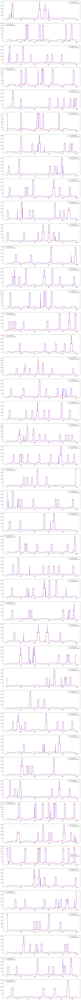

In [99]:
obs_hat, states_hat, trans_hat, theta_hat = PF.fit(true_values)

In [66]:
class SIR_HMM_class:

    def __init__(self,N,buffer,Nb_states,alpha,mu_0,tausq_0,sigmasq):
        ### Create storage ###
        self.N = N # number of particles
        self.Nb_states = Nb_states # number of possible states
        self.buffer = buffer # the length of the state sequence we will keep in memory
        
        # state space
        self.particles = np.zeros((buffer,N),dtype=np.int64) # hidden states of the hmm
        
        # importance weights
        self.weights = np.zeros((buffer,N),dtype=np.double)
        self.v = np.zeros(N,dtype=np.double)
        
        # bayesian sufficient statistics
        self.transition_counts = np.zeros((N,Nb_states,Nb_states),dtype=np.int64) # number of transitions from one hidden state to an other
        self.obs_sum = np.zeros((N,Nb_states),dtype=np.double) # the sum of all observations until current time for each particle and each possible state
        self.Nb_obs = np.zeros((N,Nb_states),dtype=np.int64) # the number of observations until current time for each particle and each possible state
        
        # parameters
        self.transition_mat = np.zeros((N,Nb_states,Nb_states),dtype=np.double) # transition matrix for each particle
        self.theta = np.zeros((N,Nb_states),dtype=np.double) # mean of the gaussian distribution put on observations for each particle and each possible state
        
        # priors
        assert len(alpha)==Nb_states and len(mu_0)==Nb_states and len(tausq_0)==Nb_states #and len(sigmasq)==Nb_states
        self.alpha = alpha
        self.mu_0 = mu_0
        self.tausq_0 = tausq_0
        self.sigmasq = sigmasq
        
        # posteriors
        self.mu_n = np.tile(mu_0,N).reshape(N,Nb_states)
        self.tausq_n = np.tile(tausq_0,N).reshape(N,Nb_states)
        
        ### Initialize parameters from priors ###
        self.initialize_params()
        
    def initialize_params(self):
        # Initalize parameters from priors
        for i in range(self.N):
            self.transition_mat[i,:,:] = dirichlet.rvs(alpha=self.alpha,size=self.Nb_states)
            self.theta[i,:] = [norm.rvs(loc=self.mu_0[state],scale=np.sqrt(self.tausq_0[state])) for state in range(self.Nb_states)]
        
    def compute_offsprings(self,W):
        weights_cumsum = np.hstack((0,np.cumsum(W)))
        offsprings = np.zeros(self.N,dtype=np.int64)
        U = uniform.rvs(scale=1./self.N)
        U_inc = 0
        for i in np.arange(1,self.N+1):
            while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
                offsprings[i-1] = offsprings[i-1] + 1
                U_inc = U_inc + 1./self.N
        return offsprings    
    
    def add_data(self,observations):
        # the data must be 1D
        _observations = np.atleast_1d(observations)
        assert _observations.ndim == 1
        # if there was already data we concatenate it, else we create the attribut
        if hasattr(self, 'obs'):
            self.obs = np.hstack((self.obs,_observations))
        else:
            self.obs = _observations
        
    def initial_step(self):
        self.step = 0
        for i in range(self.N):
            # Sample particles
            _transition_unnorm = [norm.pdf(self.obs[0],loc=self.theta[i,state],scale=np.sqrt(self.sigmasq[state])) for state in range(self.Nb_states)]
            self.particles[0,i] = np.random.choice(self.Nb_states,p=_transition_unnorm/np.sum(_transition_unnorm))
            
            # Compute unnormalize weights
            self.v[i] = np.sum(_transition_unnorm)
            
            # Compute bayesian sufficient statistics
            self.obs_sum[i,self.particles[0,i]] += self.obs[0]
            self.Nb_obs[i,self.particles[0,i]] += 1
            
            # Sample parameters
            self.tausq_n[i,self.particles[0,i]] = 1./(1./self.tausq_0[self.particles[0,i]] + self.Nb_obs[i,self.particles[0,i]]/self.sigmasq[self.particles[0,i]])
            self.mu_n[i,self.particles[0,i]] = (self.mu_0[self.particles[0,i]]/self.tausq_0[self.particles[0,i]] + self.obs_sum[i,self.particles[0,i]]/self.sigmasq[self.particles[0,i]])*self.tausq_n[i,self.particles[0,i]]
            self.theta[i,:] = [norm.rvs(loc=self.mu_n[i,state],scale=np.sqrt(self.tausq_n[i,state])) for state in range(self.Nb_states)]
        
        # Compute weights
        self.weights[0,:] = self.v/np.sum(self.v)
        
        ### Resample particles ###
        # compute offsprings
        offsprings = self.compute_offsprings(self.weights[0,:])
        new_particles_idx = np.repeat(range(self.N),offsprings)
        # resample
        self.particles[0,:] = self.particles[0,new_particles_idx]
        self.transition_mat = self.transition_mat[new_particles_idx,:,:]
        self.obs_sum = self.obs_sum[new_particles_idx,:]
        self.Nb_obs = self.Nb_obs[new_particles_idx,:]
        self.mu_n = self.mu_n[new_particles_idx,:]
        self.tausq_n = self.tausq_n[new_particles_idx,:]
        self.theta = self.theta[new_particles_idx,:]
        self.weights[0,:] = np.repeat(1./self.N,self.N)
        
        return self.compute_estimator(self.particles[0,:],self.weights[0,:])
        
    def next_step(self,verbose):
        self.step += 1
        k = min(self.step,self.buffer-1)
        # we move the particles and weights
        if self.step > self.buffer:
            _temp_particles = np.zeros((self.buffer,self.N),dtype=np.int64)
            _temp_particles[0:k,:] = self.particles[1:(k+1),:]
            self.particles = _temp_particles
            _temp_weights = np.zeros((self.buffer,self.N),dtype=np.double)
            _temp_weights[0:k,:] = self.weights[1:(k+1),:]
            self.weights = _temp_weights
        #print('particles step {}'.format(self.step),self.particles)
        ### Resample particles (and weights) ###
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(self.step))
            print('particles before resampling',self.particles[k-1,:])
            print('theta before resampling',self.theta)
        # compute weights 
        for i in range(self.N):
            _transition_unnorm = self.transition_mat[i,self.particles[k-1,i],:] * [norm.pdf(self.obs[self.step],loc=self.theta[i,state],scale=np.sqrt(self.sigmasq[state])) for state in range(self.Nb_states)]
            self.v[i] = np.sum(_transition_unnorm)
        #print('v',self.v)
        if np.sum(self.v) == 0.:
            #print('v nul')
            # case when all particles are unlikely (we put uniform weights on all particles)
            self.weights[k-1,:] = np.repeat(1./self.N,self.N)
        else:
            #print('v non nul')
            self.weights[k-1,:] = self.v/np.sum(self.v)
        # compute offsprings
        #print('weights compute', self.v/np.sum(self.v))
        #print('weights',self.weights[k-1,:])
        offsprings = self.compute_offsprings(self.weights[k-1,:])
        new_particles_idx = np.repeat(range(self.N),offsprings)
        #print('new_id',new_particles_idx)
        # resample
        self.particles[0:k,:] = self.particles[0:k,new_particles_idx]
        self.transition_counts = self.transition_counts[new_particles_idx,:,:]
        self.transition_mat = self.transition_mat[new_particles_idx,:,:]
        self.obs_sum = self.obs_sum[new_particles_idx,:]
        self.Nb_obs = self.Nb_obs[new_particles_idx,:]
        self.mu_n = self.mu_n[new_particles_idx,:]
        self.tausq_n = self.tausq_n[new_particles_idx,:]
        self.theta = self.theta[new_particles_idx,:]
        self.weights[k-1,:] = np.repeat(1./self.N,self.N)
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after resampling',self.particles[k-1,:])
            print('theta after resampling',self.theta)
        
        # Sample new particles
        for i in range(self.N):
            _transition_unnorm = self.transition_mat[i,self.particles[k-1,i],:] * [norm.pdf(self.obs[self.step],loc=self.theta[i,state],scale=np.sqrt(self.sigmasq[state])) for state in range(self.Nb_states)]
            self.particles[k,i] = np.random.choice(self.Nb_states,p=_transition_unnorm/np.sum(_transition_unnorm))    
            
            # Update sufficient statistics
            self.transition_counts[i,self.particles[k-1,i],self.particles[k,i]]+=1
            self.obs_sum[i,self.particles[k,i]]+=self.obs[self.step]
            self.Nb_obs[i,self.particles[k,i]]+=1
            
        # Sample parameters
        for i in range(self.N):
            self.tausq_n[i,self.particles[k,i]] = 1./(1./self.tausq_0[self.particles[k,i]] + self.Nb_obs[i,self.particles[k,i]]/self.sigmasq[self.particles[k,i]])
            self.mu_n[i,self.particles[k,i]] = (self.mu_0[self.particles[k,i]]/self.tausq_0[self.particles[k,i]] + self.obs_sum[i,self.particles[k,i]]/self.sigmasq[self.particles[k,i]])*self.tausq_n[i,self.particles[k,i]]
            self.theta[i,:] = [norm.rvs(loc=self.mu_n[i,state],scale=np.sqrt(self.tausq_n[i,state])) for state in range(self.Nb_states)]
            for j in range(self.Nb_states):
                self.transition_mat[i,j,:] = dirichlet.rvs(alpha=self.alpha+self.transition_counts[i,j,:])
              
        if verbose == 2:
            print('new particles ',self.particles[k,:])
            print('tausq_n',self.tausq_n)
            print('mu_n',self.mu_n)
            print('new theta ', self.theta)
            
        return self.compute_estimator(self.particles[k,:],self.weights[k,:])
        
    def estimate_state(self,particles,weights):
        set_particles = set(particles)
        unique_id_weights = [np.where(particles == particle)[0] for particle in set_particles]
        unique_weights = [np.sum(weights[idx]) for idx in unique_id_weights]
        unique_id_particles = [idx[0] for idx in unique_id_weights]
        unique_particles = particles[unique_id_particles]
        estimated_state = unique_particles[np.argmax(unique_weights)]
        return estimated_state
    
    def compute_estimator(self,particles,weights):
        state_hat = self.estimate_state(particles,weights)
        transition_mat_hat = np.mean(self.transition_mat,axis=0)
        theta_hat = np.mean(self.theta,axis=0)
        return state_hat, transition_mat_hat, theta_hat

    def state_accuracy(self,true_states,estimated_states):
        n = len(true_states)
        return np.sum(estimated_states == true_states) / float(n)
            
    def fit(self,observations,print_result=True,plot_dur=False,verbose=1):
        n = len(observations)
        if plot_dur and verbose == 0:
            verbose = 1
        if verbose == 1 or verbose == 2:
            iterator = timeprint(np.arange(1,n),plot_dur)
        else:
            iterator = np.arange(1,n)
            
        # initialize estimators
        estimated_obs = np.zeros(n,dtype=np.int64)
        estimated_states = np.zeros(n,dtype=np.int64)
        estimated_transition_mat = np.zeros((n,self.Nb_states,self.Nb_states),dtype=np.double)
        estimated_theta = np.zeros((n,self.Nb_states),dtype=np.double)
            
        # load data
        self.add_data(observations)
        
        # first step
        estimated_states[0], estimated_transition_mat[0,:,:], estimated_theta[0,:] = self.initial_step()
        estimated_obs[0] = estimated_theta[0,estimated_states[0]]
          
        # iterations
        for step in iterator:
            estimated_states[step], estimated_transition_mat[step,:,:], estimated_theta[step,:] = self.next_step(verbose)
            estimated_obs[step] = estimated_theta[step,estimated_states[step]]
        
        # print the result
        if print_result:
            print("Estimators of the transition matrix at the end: ")
            print(estimated_transition_mat[n-1,:,:])
            print("\n Estimators of the observations means at the end: ")
            print(estimated_theta[n-1,:])
            
            # plot results
            nb_plots = (n // 1000) + 1
            fig, axes = plt.subplots(nb_plots,1,figsize=(17,5*nb_plots))

            for t in np.arange(0,nb_plots*1000,1000):
                axes[t//1000].plot(observations[t:(t+1000)],color='red',label='true observations')
                axes[t//1000].plot(estimated_obs[t:(t+1000)],linestyle='--',color='blue',label='estimated observations')
                axes[t//1000].legend(loc='best');
            
        return estimated_obs, estimated_states, estimated_transition_mat, estimated_theta

In [65]:
class SIR_Factorial_HMM:

    def __init__(self,N,buffer,Nb_chains,Nb_states,alpha,mu_0,tausq_0,sigmasq):
        ### Create storage ###
        self.N = N # number of particles
        self.Nb_chains = Nb_chains # number of chains
        assert len(Nb_states)==Nb_chains
        self.Nb_states = Nb_states # number of possible states for each chain
        self.possible_states = [state for state in itertools.product(*[range(i) for i in Nb_states])]
        self.Nb_possible_states = len(self.possible_states)
        self.buffer = buffer # the length of the state space (and weights) sequence we will keep in memory
        
        # state space
        self.particles = np.zeros((Nb_chains,buffer,N),dtype=np.int64) # hidden states of each chains
        self.obs = np.zeros((Nb_chains,buffer,N),dtype=np.int64) # hidden observations of each chains
        
        # importance weights
        self.weights = np.zeros((buffer,N),dtype=np.double)
        self.v = np.zeros(N,dtype=np.double)
        
        self.transition_counts = np.empty(Nb_chains,dtype=object)
        self.obs_sum = np.empty(Nb_chains,dtype=object)
        self.Nb_obs = np.empty(Nb_chains,dtype=object)
        self.transition_mat = np.empty(Nb_chains,dtype=object)
        self.theta = np.empty(Nb_chains,dtype=object)
        self.alpha = np.empty(Nb_chains,dtype=object)
        self.mu_0 = np.empty(Nb_chains,dtype=object)
        self.tausq_0 = np.empty(Nb_chains,dtype=object)
        self.sigmasq = np.empty(Nb_chains,dtype=object)
        self.mu_n = np.empty(Nb_chains,dtype=object)
        self.tausq_n = np.empty(Nb_chains,dtype=object)
        assert len(alpha)==Nb_chains and len(mu_0)==Nb_chains and len(tausq_0)==Nb_chains  and len(sigmasq)==Nb_chains 
        for j in range(Nb_chains):
            # bayesian sufficient statistics
            self.transition_counts[j] = np.zeros((N,Nb_states[j],Nb_states[j]),dtype=np.int64) # number of transitions from one hidden state to an other
            self.obs_sum[j] = np.zeros((N,Nb_states[j]),dtype=np.double) # the sum of all observations until current time for each particle and each possible state
            self.Nb_obs[j] = np.zeros((N,Nb_states[j]),dtype=np.int64) # the number of observations until current time for each particle and each possible state
        
            # parameters
            self.transition_mat[j] = np.zeros((N,Nb_states[j],Nb_states[j]),dtype=np.double) # transition matrix for each particle
            self.theta[j] = np.zeros((N,Nb_states[j]),dtype=np.double) # mean of the gaussian distribution put on observations for each particle and each possible state
        
            # priors
            assert len(alpha[j])==Nb_states[j] and len(mu_0[j])==Nb_states[j] and len(tausq_0[j])==Nb_states[j] and len(sigmasq[j])==Nb_states[j]
            self.alpha[j] = alpha[j]
            self.mu_0[j] = mu_0[j]
            self.tausq_0[j] = tausq_0[j]
            self.sigmasq[j] = sigmasq[j]
        
            # posteriors
            self.mu_n[j] = np.tile(mu_0[j],N).reshape(N,Nb_states[j])
            self.tausq_n[j] = np.tile(tausq_0[j],N).reshape(N,Nb_states[j])
        
        ### Initialize parameters from priors ###
        self.initialize_params()
        
    def initialize_params(self):
        # Initalize parameters from priors
        for j in range(self.Nb_chains):
            for i in range(self.N):
                self.transition_mat[j][i,:,:] = dirichlet.rvs(alpha=self.alpha[j],size=self.Nb_states[j])
                self.theta[j][i,:] = [norm.rvs(loc=self.mu_0[j][state],scale=np.sqrt(self.tausq_0[j][state])) for state in range(self.Nb_states[j])]
        
    def compute_offsprings(self,W):
        weights_cumsum = np.hstack((0,np.cumsum(W)))
        offsprings = np.zeros(self.N,dtype=np.int64)
        U = uniform.rvs(scale=1./self.N)
        U_inc = 0
        for i in np.arange(1,self.N+1):
            while U_inc < 1 and U + U_inc >= weights_cumsum[i-1] and U + U_inc <= weights_cumsum[i]:
                offsprings[i-1] = offsprings[i-1] + 1
                U_inc = U_inc + 1./self.N
        return offsprings    
    
    def add_data(self,observations):
        # the data must be 1D
        _observations = np.atleast_1d(observations)
        assert _observations.ndim == 1
        # if there was already data we concatenate it, else we create the attribut
        if hasattr(self, 'agg_obs'):
            self.agg_obs = np.hstack((self.agg_obs,_observations))
        else:
            self.agg_obs = _observations
        
    def initial_step(self):
        self.step = 0
        # Compute gaussian parameters
        self.sum_theta = np.zeros((self.N,len(self.possible_states)),dtype=np.double)
        self.sum_sigmasq = np.zeros(len(self.possible_states),dtype=np.double)
        for idx, state in enumerate(self.possible_states):
            for j in range(self.Nb_chains):
                self.sum_sigmasq[idx] += self.sigmasq[j][state[j]]
                for i in range(self.N):
                    self.sum_theta[i,idx] += self.theta[j][i,state[j]]
        for i in range(self.N):
            # Sample particles
            _transition_unnorm = [norm.pdf(self.agg_obs[0],
                                           loc=self.sum_theta[i,idx],
                                           scale=np.sqrt(self.sum_sigmasq[idx])) for idx in range(self.Nb_possible_states)]
            self.particles[:,0,i] = self.possible_states[np.random.choice(self.Nb_possible_states,p=_transition_unnorm/np.sum(_transition_unnorm))]
            
            # Sample hidden observations
            state_idx = getIndexOfTuple(self.possible_states,tuple(self.particles[:,0,i]))
            mu_bar = [self.theta[j][i,self.particles[j,0,i]]+self.sigmasq[j][self.particles[j,0,i]]*(self.agg_obs[0]-self.sum_theta[i,state_idx])/self.sum_sigmasq[state_idx] for j in range(self.Nb_chains)]
            Sigma_bar = np.diag([self.sigmasq[j][self.particles[j,0,i]] for j in range(self.Nb_chains)]) - np.array([[self.sigmasq[j][self.particles[j,0,i]]*self.sigmasq[l][self.particles[l,0,i]]/self.sum_sigmasq[state_idx] for l in range(self.Nb_chains)] for j in range(self.Nb_chains)])
            self.obs[:,0,i] = np.random.multivariate_normal(mean=mu_bar,cov=Sigma_bar)
            
            # Compute unnormalize weights
            self.v[i] = np.sum(_transition_unnorm)
            
            for j in range(self.Nb_chains):
                # Compute bayesian sufficient statistics
                self.obs_sum[j][i,self.particles[j,0,i]] += self.obs[j,0,i]
                self.Nb_obs[j][i,self.particles[j,0,i]] += 1
            
                # Sample parameters
                self.tausq_n[j][i,self.particles[j,0,i]] = 1./(1./self.tausq_0[j][self.particles[j,0,i]] + self.Nb_obs[j][i,self.particles[j,0,i]]/self.sigmasq[j][self.particles[j,0,i]])
                self.mu_n[j][i,self.particles[j,0,i]] = (self.mu_0[j][self.particles[j,0,i]]/self.tausq_0[j][self.particles[j,0,i]] + self.obs_sum[j][i,self.particles[j,0,i]]/self.sigmasq[j][self.particles[j,0,i]])*self.tausq_n[j][i,self.particles[j,0,i]]
                self.theta[j][i,:] = [norm.rvs(loc=self.mu_n[j][i,state],scale=np.sqrt(self.tausq_n[j][i,state])) for state in range(self.Nb_states[j])]
        
        # Compute weights
        self.weights[0,:] = self.v/np.sum(self.v)
        
        ### Resample particles ###
        # compute offsprings
        offsprings = self.compute_offsprings(self.weights[0,:])
        new_particles_idx = np.repeat(range(self.N),offsprings)
        # resample
        self.particles[:,0,:] = self.particles[:,0,new_particles_idx]
        self.obs[:,0,:] = self.obs[:,0,new_particles_idx]
        for j in range(self.Nb_chains):
            self.transition_mat[j] = self.transition_mat[j][new_particles_idx,:,:]
            self.obs_sum[j] = self.obs_sum[j][new_particles_idx,:]
            self.Nb_obs[j] = self.Nb_obs[j][new_particles_idx,:]
            self.theta[j] = self.theta[j][new_particles_idx,:]
            self.mu_n[j] = self.mu_n[j][new_particles_idx,:]
            self.tausq_n[j] = self.tausq_n[j][new_particles_idx,:]
        self.weights[0,:] = np.repeat(1./self.N,self.N)
        
        return self.compute_estimator(self.particles[:,0,:],self.weights[0,:])
        
    def next_step(self,verbose):
        self.step += 1
        k = min(self.step,self.buffer-1)
        # we move the particles and weights
        if self.step > self.buffer:
            _temp_particles = np.zeros((self.Nb_chains,self.buffer,self.N),dtype=np.int64)
            _temp_particles[:,0:k,:] = self.particles[:,1:(k+1),:]
            self.particles = _temp_particles
            _temp_obs = np.zeros((self.Nb_chains,self.buffer,self.N),dtype=np.int64)
            _temp_obs[:,0:k,:] = self.obs[:,1:(k+1),:]
            self.obs = _temp_obs
            _temp_weights = np.zeros((self.buffer,self.N),dtype=np.double)
            _temp_weights[0:k,:] = self.weights[1:(k+1),:]
            self.weights = _temp_weights
        #print('particles step {}'.format(self.step),self.particles)
        ### Resample particles (and weights) ###
        if verbose == 2:
            print('\n\n-------- step {} ---------'.format(self.step))
            print('particles before resampling',self.particles[:,k-1,:])
            print('theta before resampling',self.theta)
        # compute weights 
        for i in range(self.N):
            _transition_unnorm = [np.prod([self.transition_mat[j][i,self.particles[j,k-1,i],state[j]] for j in range(self.Nb_chains)]) \
                                  *norm.pdf(self.agg_obs[self.step],
                                           loc=self.sum_theta[i,idx],
                                           scale=np.sqrt(self.sum_sigmasq[idx])) for idx, state in enumerate(self.possible_states)]
            self.v[i] = np.sum(_transition_unnorm)
        #print('v',self.v)
        if np.sum(self.v) == 0.:
            #print('v nul')
            # case when all particles are unlikely (we put uniform weights on all particles)
            self.weights[k-1,:] = np.repeat(1./self.N,self.N)
        else:
            #print('v non nul')
            self.weights[k-1,:] = self.v/np.sum(self.v)
        # compute offsprings
        #print('weights compute', self.v/np.sum(self.v))
        #print('weights',self.weights[k-1,:])
        offsprings = self.compute_offsprings(self.weights[k-1,:])
        new_particles_idx = np.repeat(range(self.N),offsprings)
        #print('new_id',new_particles_idx)
        # resample
        self.particles[:,0:k,:] = self.particles[:,0:k,new_particles_idx]
        self.obs[:,0:k,:] = self.obs[:,0:k,new_particles_idx]
        for j in range(self.Nb_chains):
            self.transition_counts[j] = self.transition_counts[j][new_particles_idx,:,:]
            self.transition_mat[j] = self.transition_mat[j][new_particles_idx,:,:]
            self.obs_sum[j] = self.obs_sum[j][new_particles_idx,:]
            self.Nb_obs[j] = self.Nb_obs[j][new_particles_idx,:]
            self.theta[j] = self.theta[j][new_particles_idx,:]
            self.mu_n[j] = self.mu_n[j][new_particles_idx,:]
            self.tausq_n[j] = self.tausq_n[j][new_particles_idx,:]
        self.weights[k-1,:] = np.repeat(1./self.N,self.N)
        
        if verbose == 2:
            print('offsprings',offsprings)
            print('particles after resampling',self.particles[:,k-1,:])
            print('theta after resampling',self.theta)
        
        # Compute gaussian parameters
        self.sum_theta = np.zeros((self.N,len(self.possible_states)),dtype=np.double)
        self.sum_sigmasq = np.zeros(len(self.possible_states),dtype=np.double)
        for idx, state in enumerate(self.possible_states):
            for j in range(self.Nb_chains):
                self.sum_sigmasq[idx] += self.sigmasq[j][state[j]]
                for i in range(self.N):
                    self.sum_theta[i,idx] += self.theta[j][i,state[j]]
        
        # Sample new particles
        for i in range(self.N):
            _transition_unnorm = [np.prod([self.transition_mat[j][i,self.particles[j,k-1,i],state[j]] for j in range(self.Nb_chains)]) \
                                  *norm.pdf(self.agg_obs[self.step],
                                           loc=self.sum_theta[i,idx],
                                           scale=np.sqrt(self.sum_sigmasq[idx])) for idx, state in enumerate(self.possible_states)]
            self.particles[:,k,i] = self.possible_states[np.random.choice(self.Nb_possible_states,p=_transition_unnorm/np.sum(_transition_unnorm))]
            
            # Sample hidden observations
            state_idx = getIndexOfTuple(self.possible_states,tuple(self.particles[:,k,i]))
            mu_bar = [self.theta[j][i,self.particles[j,k,i]]+self.sigmasq[j][self.particles[j,k,i]]*(self.agg_obs[self.step]-self.sum_theta[i,state_idx])/self.sum_sigmasq[state_idx] for j in range(self.Nb_chains)]
            Sigma_bar = np.diag([self.sigmasq[j][self.particles[j,k,i]] for j in range(self.Nb_chains)]) - np.array([[self.sigmasq[j][self.particles[j,k,i]]*self.sigmasq[l][self.particles[l,k,i]]/self.sum_sigmasq[state_idx] for l in range(self.Nb_chains)] for j in range(self.Nb_chains)])
            self.obs[:,k,i] = np.random.multivariate_normal(mean=mu_bar,cov=Sigma_bar)
            
            for j in range(self.Nb_chains):
                # Update bayesian sufficient statistics
                self.transition_counts[j][i,self.particles[j,k-1,i],self.particles[j,k,i]]+=1
                self.obs_sum[j][i,self.particles[j,k,i]] += self.obs[j,k,i]
                self.Nb_obs[j][i,self.particles[j,k,i]] += 1
            
                # Sample parameters
                self.tausq_n[j][i,self.particles[j,k,i]] = 1./(1./self.tausq_0[j][self.particles[j,k,i]] + self.Nb_obs[j][i,self.particles[j,k,i]]/self.sigmasq[j][self.particles[j,k,i]])
                self.mu_n[j][i,self.particles[j,k,i]] = (self.mu_0[j][self.particles[j,k,i]]/self.tausq_0[j][self.particles[j,k,i]] + self.obs_sum[j][i,self.particles[j,k,i]]/self.sigmasq[j][self.particles[j,k,i]])*self.tausq_n[j][i,self.particles[j,k,i]]
                self.theta[j][i,:] = [norm.rvs(loc=self.mu_n[j][i,state],scale=np.sqrt(self.tausq_n[j][i,state])) for state in range(self.Nb_states[j])]
                for k in range(self.Nb_states[j]):
                    self.transition_mat[j][i,k,:] = dirichlet.rvs(alpha=self.alpha[j]+self.transition_counts[j][i,k,:])
    
        if verbose == 2:
            print('new particles ',self.particles[:,k,:])
            print('tausq_n',self.tausq_n)
            print('mu_n',self.mu_n)
            print('new theta ', self.theta)
            
        return self.compute_estimator(self.particles[:,k,:],self.weights[k,:])
        
    def estimate_state(self,particles,weights):
        set_particles = set(particles)
        unique_id_weights = [np.where(particles == particle)[0] for particle in set_particles]
        unique_weights = [np.sum(weights[idx]) for idx in unique_id_weights]
        unique_id_particles = [idx[0] for idx in unique_id_weights]
        unique_particles = particles[unique_id_particles]
        estimated_state = unique_particles[np.argmax(unique_weights)]
        return estimated_state
    
    def compute_estimator(self,particles,weights):
        state_hat = [self.estimate_state(particles[j,:],weights) for j in range(self.Nb_chains)]
        transition_mat_hat = [np.mean(self.transition_mat[j],axis=0) for j in range(self.Nb_chains)]
        theta_hat = [np.mean(self.theta[j],axis=0) for j in range(self.Nb_chains)]
        return state_hat, transition_mat_hat, theta_hat

    def state_accuracy(self,true_states,estimated_states):
        n = len(true_states)
        return np.sum(estimated_states == true_states) / float(n)
            
    def fit(self,observations,true_values=None,print_result=True,plot_dur=False,verbose=1):
        n = len(observations)
        if plot_dur and verbose == 0:
            verbose = 1
        if verbose == 1 or verbose == 2:
            iterator = timeprint(np.arange(1,n),plot_dur)
        else:
            iterator = np.arange(1,n)
            
        # initialize estimators
        estimated_agg_obs = np.zeros(n,dtype=np.int64)
        estimated_obs = np.zeros((n,self.Nb_chains),dtype=np.int64)
        estimated_states = np.zeros((n,self.Nb_chains),dtype=np.int64)
        estimated_transition_mat = np.empty(self.Nb_chains,dtype=object)
        estimated_theta = np.empty(self.Nb_chains,dtype=object)
        for j in range(self.Nb_chains):
            estimated_transition_mat[j] = np.zeros((n,self.Nb_states[j],self.Nb_states[j]),dtype=np.double)
            estimated_theta[j] = np.zeros((n,self.Nb_states[j]),dtype=np.double)
            
        # load data
        self.add_data(observations)
        
        # first step
        estimated_states[0,:], _estimated_transition_mat, _estimated_theta = self.initial_step()
        for j in range(self.Nb_chains):
            estimated_transition_mat[j][0,:,:] = _estimated_transition_mat[j]
            estimated_theta[j][0,:] = _estimated_theta[j]
            estimated_obs[0,j] = estimated_theta[j][0,estimated_states[0,j]]
            estimated_agg_obs[0] += estimated_obs[0,j]
          
        # iterations
        for step in iterator:
            estimated_states[step,:], _estimated_transition_mat, _estimated_theta = self.next_step(verbose)
            for j in range(self.Nb_chains):
                estimated_transition_mat[j][step,:,:] = _estimated_transition_mat[j]
                estimated_theta[j][step,:] = _estimated_theta[j]
                estimated_obs[step,j] = estimated_theta[j][step,estimated_states[step,j]]
                estimated_agg_obs[step] += estimated_obs[step,j]
        
        # print the result
        if print_result:
            print("--- Estimators of the transition matrix at the end ---")
            for j in range(self.Nb_chains):
                print("Chain {}".format(j))
                print(estimated_transition_mat[j][n-1,:,:])
            print("\n--- Estimators of the observations means at the end ---")
            for j in range(self.Nb_chains):
                print("Chain {}".format(j))
                print(estimated_theta[j][n-1,:])
            
            # plot results
            assert true_values is not None 
            true_values = np.atleast_2d(true_values)
            assert true_values.ndim==2
            
            interval = min(n,1000)
            
            if n%1000 == 0:
                nb_plots = (n // 1000)*self.Nb_chains
            else:
                nb_plots = ((n // 1000) + 1)*self.Nb_chains
            fig, axes = plt.subplots(nb_plots,1,figsize=(17,5*nb_plots))

            for t in np.arange(0,(nb_plots//self.Nb_chains)*1000,1000):
                for j in range(self.Nb_chains):
                    axes[(t//1000)*self.Nb_chains+j].plot(np.arange(t,t+interval),true_values[t:(t+1000),j],color='red',label='true observations')
                    axes[(t//1000)*self.Nb_chains+j].plot(np.arange(t,t+interval),estimated_obs[t:(t+1000),j],linestyle='--',color='blue',label='estimated observations')
                    axes[(t//1000)*self.Nb_chains+j].set_title('Chain {}'.format(j))
                    axes[(t//1000)*self.Nb_chains+j].legend(loc='best');
            
        return estimated_agg_obs, estimated_obs, estimated_states, estimated_transition_mat, estimated_theta

In [5]:
import sqlite3

In [9]:
house_id = 483
device = 'refrigerator'

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()

# we get all the columns (non equal to 0) associated with the device
alldevices = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
# we stock the data for these columns and we change the unit to Watts
powers = data.loc[:,alldevices]*1000

In [7]:
true_values = np.zeros((30660,2),dtype=np.double)

In [10]:
true_values[:,1]=powers.values.T[0]

In [11]:
observations = np.sum(true_values,axis=1)

In [12]:
observations

array([ 138.,  129.,  129., ...,    6.,   15.,   12.])

In [16]:
obs_mu = {}
obs_sigmasq = {}
obs_tausq = {}
Nb_states = {}

for key_device, device in priors_hyperparams.items():
    obs_mu[key_device] = [priors_hyperparams[key_device][mode]['Obs gaussian']['mu_0'] for mode in device.keys()]
    obs_sigmasq[key_device] = [priors_hyperparams[key_device][mode]['Obs gaussian']['sigmasq'] for mode in device.keys()]
    obs_tausq[key_device] = [priors_hyperparams[key_device][mode]['Obs gaussian']['tausq_0'] for mode in device.keys()]
    Nb_states[key_device] = len(device)

In [ ]:
L = 2
print(device)
params = {'Nb_states': Nb_states[device]*L, 'alpha': np.repeat(1./(Nb_states[device]*L),Nb_states[device]*L),
         'mu_0':np.repeat(obs_mu[device],L),'tausq_0':np.repeat(obs_tausq[device],L),'sigmasq':np.repeat(obs_sigmasq[device],L)}

In [25]:
list_device = ['air','refrigerator']
print(list_device)
params = {'Nb_states': [],'alpha': [],'mu_0':[],'tausq_0':[],'sigmasq':[]}
L = {'air':4,'refrigerator':1}
for device in list_device:
    params['Nb_states'].append(Nb_states[device]*L[device])
    params['alpha'].append(np.repeat(1./(Nb_states[device]*L[device]),Nb_states[device]*L[device]))
    params['mu_0'].append(np.repeat(obs_mu[device],L[device]))
    params['tausq_0'].append(np.repeat(obs_tausq[device],L[device]))
    params['sigmasq'].append(np.repeat(obs_sigmasq[device],L[device]))

['air', 'refrigerator']


In [26]:
params

{'Nb_states': [8, 3],
 'alpha': [array([ 0.125,  0.125,  0.125,  0.125,  0.125,  0.125,  0.125,  0.125]),
  array([ 0.33333333,  0.33333333,  0.33333333])],
 'mu_0': [array([  3.91216742e+03,   3.91216742e+03,   3.91216742e+03,
           3.91216742e+03,   7.44821441e-02,   7.44821441e-02,
           7.44821441e-02,   7.44821441e-02]),
  array([ 417.41317548,  124.1855719 ,    2.15512267])],
 'sigmasq': [array([  1.17429440e+05,   1.17429440e+05,   1.17429440e+05,
           1.17429440e+05,   3.10059795e+00,   3.10059795e+00,
           3.10059795e+00,   3.10059795e+00]),
  array([ 140.44266948,  164.76495975,   23.90045368])],
 'tausq_0': [array([  2.59027923e+04,   2.59027923e+04,   2.59027923e+04,
           2.59027923e+04,   8.35662617e-04,   8.35662617e-04,
           8.35662617e-04,   8.35662617e-04]),
  array([ 139.9854057 ,  243.28831649,    3.33708755])]}

In [19]:
params

{'Nb_states': [4, 6],
 'alpha': [array([ 0.25,  0.25,  0.25,  0.25]),
  array([ 0.16666667,  0.16666667,  0.16666667,  0.16666667,  0.16666667,
          0.16666667])],
 'mu_0': [array([  3.91216742e+03,   3.91216742e+03,   7.44821441e-02,
           7.44821441e-02]),
  array([ 417.41317548,  417.41317548,  124.1855719 ,  124.1855719 ,
            2.15512267,    2.15512267])],
 'sigmasq': [array([  1.17429440e+05,   1.17429440e+05,   3.10059795e+00,
           3.10059795e+00]),
  array([ 140.44266948,  140.44266948,  164.76495975,  164.76495975,
           23.90045368,   23.90045368])],
 'tausq_0': [array([  2.59027923e+04,   2.59027923e+04,   8.35662617e-04,
           8.35662617e-04]),
  array([ 139.9854057 ,  139.9854057 ,  243.28831649,  243.28831649,
            3.33708755,    3.33708755])]}

In [32]:
PF_F = SIR_Factorial_HMM(N=50,buffer=50,Nb_chains=2,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.
/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 30659 done in 0.5409sec   
0.5404sec avg, 16569.3677sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[  4.16682615e-01   1.56216230e-01   2.78164169e-01   7.12136284e-02
    2.88238636e-04   7.74351192e-02]
 [  9.84323019e-03   9.12221804e-01   1.40397363e-02   5.10631604e-02
    1.21750707e-02   6.56997961e-04]
 [  4.15273495e-01   7.42258991e-03   6.77266896e-02   4.53087386e-01
    8.14009517e-04   5.56758309e-02]
 [  7.89693017e-04   2.27401499e-02   3.27531118e-02   4.53577048e-03
    7.97187620e-01   1.41993655e-01]
 [  5.17508394e-05   1.94189426e-02   1.42874177e-02   9.57637740e-01
    4.82225140e-03   3.78189763e-03]
 [  3.01124411e-03   9.47012218e-03   1.74859954e-02   1.63031518e-05
    1.14564806e-04   9.69901770e-01]]
Chain 1
[[  8.41487140e-01   2.34990099e-03   7.70372246e-03   1.13642881e-02
    3.92967520e-02   8.53474508e-02   1.13508723e-02   7.53518983e-04
    3.46354707e-04]
 [  3.31356279e-01   1.83809697e-02   1.07762356e-01   3.7

ValueError: x and y must have same first dimension, but have shapes (1000,) and (660,)

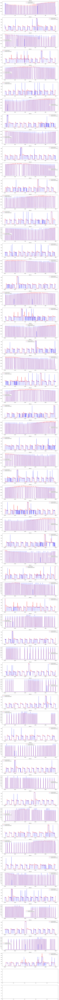

In [33]:
T = 30660
_ = PF_F.fit(observations=observations[:T],true_values=true_values[:T])

In [34]:
PF_F = SIR_Factorial_HMM(N=100,buffer=50,Nb_chains=2,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.
/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 1999 done in 0.5475sec   
0.5378sec avg, 1075.0708sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[  5.50056667e-01   3.17782051e-02   3.54408834e-02   9.64515664e-02
    3.58094110e-04   4.15406564e-02   1.80867154e-04   2.44193060e-01]
 [  3.77404752e-02   4.49895271e-02   8.80876635e-01   8.34259698e-04
    1.18487433e-03   9.76040886e-04   3.26831026e-02   7.15085493e-04]
 [  7.98149955e-04   9.57729285e-01   5.13502716e-04   6.48624209e-04
    7.31095402e-04   3.82545051e-02   5.43878072e-04   7.80959998e-04]
 [  2.80588250e-02   8.86143247e-01   4.08487002e-03   6.02971009e-02
    6.63737559e-03   7.12043771e-03   3.44816696e-03   4.20997662e-03]
 [  1.27166940e-02   2.74577309e-03   1.34851863e-02   1.63578251e-04
    8.77261030e-01   1.56277464e-04   8.41759570e-02   9.29550405e-03]
 [  7.64272488e-02   1.95934440e-03   1.62135757e-03   2.21270502e-03
    8.85241504e-01   2.77265742e-02   2.36480585e-03   2.44646036e-03]
 [  1.09284129e-01   2.11

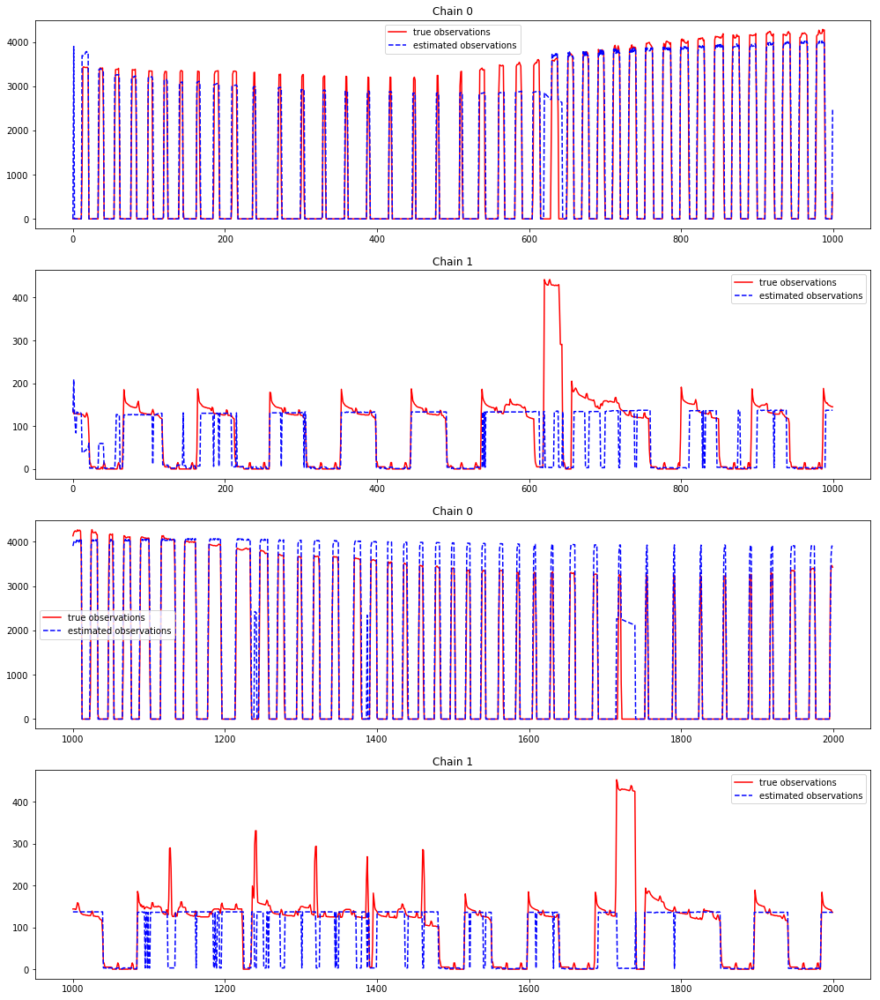

In [35]:
T = 2000
_ = PF_F.fit(observations=observations[:T],true_values=true_values[:T])

In [40]:
list(_[2][:,0])

[5,
 0,
 4,
 5,
 5,
 5,
 7,
 7,
 7,
 7,
 7,
 7,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 3,
 3,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 4,
 7,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 4,
 4,
 4,
 7,
 7,
 7,
 7,
 4,
 7,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 4,
 4,
 4,
 7,
 7,
 4,
 7,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 7,
 7,
 7,
 7,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 0,
 0,
 0,
 0,
 7,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,


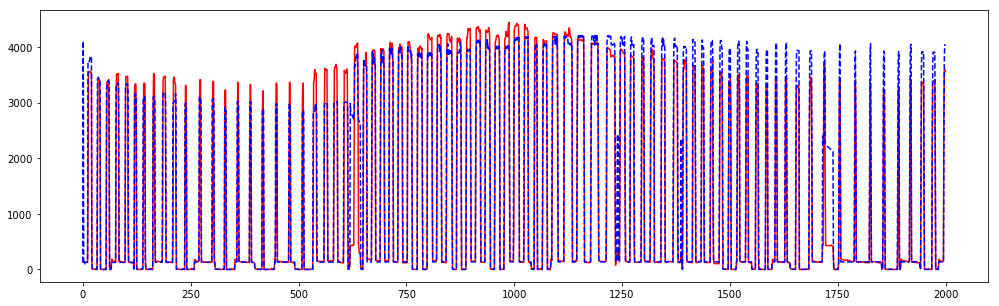

In [36]:
plt.figure(figsize=(17,5))
T=2000
plt.plot(observations[:T],color='red')
plt.plot(_[0][:T],color='blue',linestyle='--');

In [39]:
PF_F.add_data(observations[:10])

In [40]:
PF_F.initial_step()

([0, 0], [array([[ 0.05618028,  0.51001539,  0.28690725,  0.14689708],
         [ 0.39402935,  0.12723219,  0.14915961,  0.32957885],
         [ 0.3456782 ,  0.26153512,  0.28791734,  0.10486933],
         [ 0.24600421,  0.0734097 ,  0.42905193,  0.25153416]]),
  array([[ 0.15297207,  0.07257944,  0.1918816 ,  0.16288931,  0.34325637,
           0.07642121],
         [ 0.36145583,  0.32640034,  0.10316851,  0.08657279,  0.03140325,
           0.09099928],
         [ 0.10163225,  0.17029029,  0.12277359,  0.10364107,  0.2549159 ,
           0.24674691],
         [ 0.01978397,  0.12857392,  0.15170158,  0.28648546,  0.34756081,
           0.06589425],
         [ 0.01430036,  0.05715829,  0.45080422,  0.16939339,  0.12978112,
           0.17856261],
         [ 0.07076934,  0.20563359,  0.16699939,  0.16913148,  0.0647455 ,
           0.32272069]])], [array([  3.31911752e+03,   2.77962640e+03,   3.27102784e-01,
           4.28426470e-01]),
  array([ 895.80812551,  454.17392562,  264.528246

In [35]:
observations[:10]

array([ 3962.,  3964.,  3965.,  3965.,  3968.,  3966.,  3959.,  3981.,
        4038.,  4036.])

In [36]:
true_values[:10,:]

array([[ 3953.,     9.],
       [ 3955.,     9.],
       [ 3956.,     9.],
       [ 3956.,     9.],
       [ 3959.,     9.],
       [ 3957.,     9.],
       [ 3951.,     8.],
       [ 3973.,     8.],
       [ 4030.,     8.],
       [ 4028.,     8.]])

In [41]:
PF_F.next_step(verbose=2)



-------- step 1 ---------
particles before resampling [[0 0 0 0 0 1 0 0 0 0]
 [1 0 0 3 3 0 2 2 2 0]]
theta before resampling [ array([[  2.28652026e+03,   1.09340186e+03,  -4.45327592e-01,
          3.59914400e-01],
       [  3.09552250e+03,   3.34957610e+03,   2.88218014e-01,
          1.28422737e-01],
       [  3.09552250e+03,   3.34957610e+03,   2.88218014e-01,
          1.28422737e-01],
       [  4.30540147e+03,   2.80475227e+03,   1.36207453e-01,
          7.86269462e-01],
       [  4.30540147e+03,   2.80475227e+03,   1.36207453e-01,
          7.86269462e-01],
       [  3.19655956e+03,   1.90861340e+03,   5.44254744e-01,
          2.26788259e-01],
       [  3.33991440e+03,   2.92955876e+03,   8.04627289e-01,
          5.13179602e-01],
       [  3.33991440e+03,   2.92955876e+03,   8.04627289e-01,
          5.13179602e-01],
       [  3.33991440e+03,   2.92955876e+03,   8.04627289e-01,
          5.13179602e-01],
       [  2.88650423e+03,   3.69691577e+03,  -9.06321113e-02,
        

([0, 0], [array([[ 0.13146617,  0.68643362,  0.06861153,  0.11348868],
         [ 0.32899682,  0.29248776,  0.20647147,  0.17204396],
         [ 0.11457014,  0.19158258,  0.39232532,  0.30152197],
         [ 0.35133225,  0.2906532 ,  0.08170215,  0.2763124 ]]),
  array([[ 0.67329321,  0.08183602,  0.04394943,  0.05255408,  0.09967921,
           0.04868806],
         [ 0.22160939,  0.16249234,  0.08769857,  0.26695923,  0.1880013 ,
           0.07323916],
         [ 0.12815309,  0.32541676,  0.04259199,  0.17914755,  0.17616429,
           0.14852632],
         [ 0.06628947,  0.3584577 ,  0.08623505,  0.12631716,  0.21275556,
           0.14994506],
         [ 0.05870048,  0.36954244,  0.12475808,  0.12394778,  0.09119123,
           0.23185999],
         [ 0.0840263 ,  0.16868611,  0.17593534,  0.23147934,  0.2024973 ,
           0.13737562]])], [array([  3.29536453e+03,   3.42458871e+03,   4.17776189e-01,
           1.68055153e-01]),
  array([  230.11687284,  1032.35484458,   245.815

In [51]:
import cProfile
cProfile.run('PF_F.next_step(verbose=1)')

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


         12362237 function calls in 14.360 seconds

   Ordered by: standard name

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
     2000    0.001    0.000    0.004    0.000 <frozen importlib._bootstrap>:989(_handle_fromlist)
     2000    0.007    0.000    0.007    0.000 <ipython-input-15-d24909ec63eb>:2(getIndexOfTuple)
        1    0.302    0.302   14.572   14.572 <ipython-input-30-b61f8e61cc85>:142(next_step)
     2000    0.356    0.000    6.314    0.003 <ipython-input-30-b61f8e61cc85>:164(<listcomp>)
     2000    0.352    0.000    6.218    0.003 <ipython-input-30-b61f8e61cc85>:211(<listcomp>)
     2000    0.012    0.000    0.012    0.000 <ipython-input-30-b61f8e61cc85>:218(<listcomp>)
     2000    0.004    0.000    0.014    0.000 <ipython-input-30-b61f8e61cc85>:219(<listcomp>)
     4000    0.068    0.000    0.918    0.000 <ipython-input-30-b61f8e61cc85>:231(<listcomp>)
        2    0.000    0.000    0.000    0.000 <ipython-input-30-b61f8e61cc85>:243(estima

## Test avec classes de priors

In [3]:
import sqlite3

In [118]:
house_id = 1830
devices = ['air','refrigerator','furnace','dishwasher']
classes = ['class 1', 'class 0', 'class 0', 'class 0']

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()

# we stock the data for the aggregated power and we change the unit to Watts
observations = data.loc[:,'use']*1000

# we stock the data for each device and we change the unit to Watts
true_values = pd.DataFrame([])
for device in devices:
    # we get all the columns (non equal to 0) associated with the device
    device_allcol = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
    chosen_col = [data.loc[:,device_allcol].sum(0).argmax()]
    true_values[device] = data.loc[:,chosen_col]*1000
    

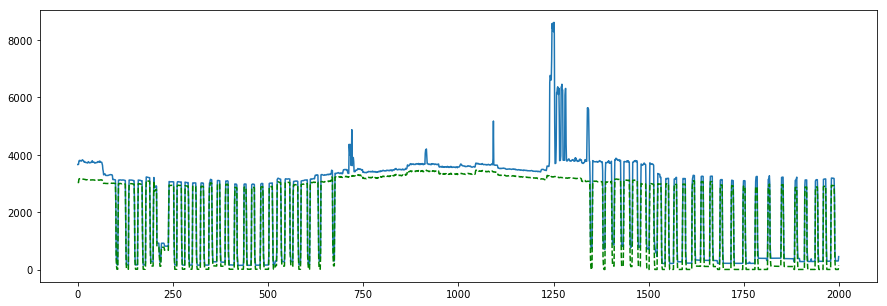

In [119]:
plt.figure(figsize=(15,5))
T = 2000
plt.plot(observations.iloc[:T].values.reshape(-1,1))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',linestyle='--');

In [120]:
priors = pd.read_table('priors.tsv', index_col=[0,1,2])
priors.sort_index(inplace=True)

In [121]:
priors

Obs dist  \
device       class   mode               
air          class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
dishwasher   class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
furnace      class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
refrigerator class 0 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   

                                                                    Obs params  \
device       class   mode                                                        
air          class 0 mode 0  {'mu_0': 48.749114657725947, 'tausq_0': 984.20...   
                     mode 1  {'mu_0': 3401.7622677963004, 'tausq_0': 183436...   
             class 1 mode 0  {'mu_0': 50.887711799790935, 'tausq_0': 2653.1...   
                     mode 1  {'mu_0': 1873.0529361852484, 'tausq_0': 215025...   
dishwasher   class 0 mode 0  {'mu_0': 2.4834949402285185, 'tausq_0': 3.5314...   
                     mode 1  {'mu_0': 904.07199265887357, 'tausq_0': 24174....   
             class 1 mode 0  {'mu_0': 0.0036382419655489927, 'tausq_0': 0.0...   
                     mode 1  {'mu_0': 2.4473684210526314, 'tausq_0': 0.0, '...   
furnace      class 0 mode 0  {'mu_0': 18.799247430169071, 'tausq_0': 115.50...   
                     mode 1  {'mu_0': 393.37424954388678, 'tausq_0': 14215....   
             class 1 mode 0  {'mu_0': 154.94670210526257, 'tausq_0': 43257....   
                     mode 1  {'mu_0': 767.48350789712515, 'tausq_0': 10151....   
refrigerator class 0 mode 0  {'mu_0': 11.003624640937971, 'tausq_0': 117.05...   
                     mode 1  {'mu_0': 111.97297668021551, 'tausq_0': 1904.6...   
                     mode 2  {'mu_0': 370.8776013487041, 'tausq_0': 22599.2...   
             class 1 mode 0  {'mu_0': 52.037733914380929, 'tausq_0': 0.0, '...   
                     mode 1  {'mu_0': 448.72807017543857, 'tausq_0': 0.0, '...   
                     mode 2  {'mu_0': 1416.3757476889614, 'tausq_0': 0.0, '...   

                               Dur dist  \
device       class   mode                 
air          class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
dishwasher   class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
furnace      class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
refrigerator class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   

                                                                    Dur params  
device       class   mode                                                       
air          class 0 mode 0  {'alpha_pi': 46.069723552177628, 'beta_pi': 6....  
                     mode 1  {'alpha_pi': 94.529550261459661, 'beta_pi': 11...  
             class 1 mode 0  {'alpha_pi': 1.0008429522197928, 'beta_pi': 0....  
                     mode 1  {'alpha_pi': 10.251878490370444, 'beta_pi': 1....  
dishwasher   class 0 mode 0  {'alpha_pi': 0.85903071351507654, 'beta_pi': 0...  
                     mode 1  {'alpha_pi': 2.4636918520456361, 'beta_pi': 0....  
             class 1 mode 0  {'alpha_pi': inf, 'beta_pi': 

In [122]:
import ast

params = {'Nb_states': [],'alpha': [],'mu_0':[],'tausq_0':[],'sigmasq':[]}
L = {'air':1,'refrigerator':1,'furnace':1,'dishwasher':1}
for device, device_class in zip(devices,classes):
    list_modes = priors.loc[(device,device_class,slice(None)),].index.get_level_values(priors.index.names[2])
    Nb_states = len(list_modes)
    params['Nb_states'].append(Nb_states*L[device])
    params['alpha'].append(np.repeat(1./(Nb_states*L[device]),Nb_states*L[device]))
    params['mu_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['mu_0'] for mode in list_modes],L[device]))
    params['tausq_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['tausq_0'] for mode in list_modes],L[device]))
    params['sigmasq'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['sigmasq'] for mode in list_modes],L[device]))

In [123]:
params

{'Nb_states': [2, 3, 2, 2],
 'alpha': [array([ 0.5,  0.5]),
  array([ 0.33333333,  0.33333333,  0.33333333]),
  array([ 0.5,  0.5]),
  array([ 0.5,  0.5])],
 'mu_0': [array([   50.8877118 ,  1873.05293619]),
  array([  11.00362464,  111.97297668,  370.87760135]),
  array([  18.79924743,  393.37424954]),
  array([   2.48349494,  904.07199266])],
 'sigmasq': [array([  55326.50097762,  139827.6501846 ]),
  array([  676.75136603,  1010.73433859,  7931.85366485]),
  array([ 2661.84392703,  3400.31378489]),
  array([   702.85860991,  37555.24141573])],
 'tausq_0': [array([   2653.1994221 ,  215025.38710514]),
  array([   117.05715529,   1904.66474252,  22599.234031  ]),
  array([   115.50732973,  14215.27668795]),
  array([  3.53143698e+00,   2.41745225e+04])]}

In [124]:
PF_F = SIR_Factorial_HMM(N=50,buffer=50,Nb_chains=4,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.
/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 1999 done in 0.2822sec   
0.2660sec avg, 531.7299sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[ 0.9048174   0.0951826 ]
 [ 0.02543999  0.97456001]]
Chain 1
[[ 0.82311047  0.07555543  0.1013341 ]
 [ 0.25366015  0.4517248   0.29461504]
 [ 0.10446879  0.03692324  0.85860797]]
Chain 2
[[ 0.85616324  0.14383676]
 [ 0.83647789  0.16352211]]
Chain 3
[[ 0.9462384   0.0537616 ]
 [ 0.04578814  0.95421186]]

--- Estimators of the observations means at the end ---
Chain 0
[   96.97495969  2288.68338914]
Chain 1
[ -2.20976866e-01   9.16749648e+01   4.71778278e+02]
Chain 2
[   6.50113571  389.08100251]
Chain 3
[    3.53219788  1012.93275611]


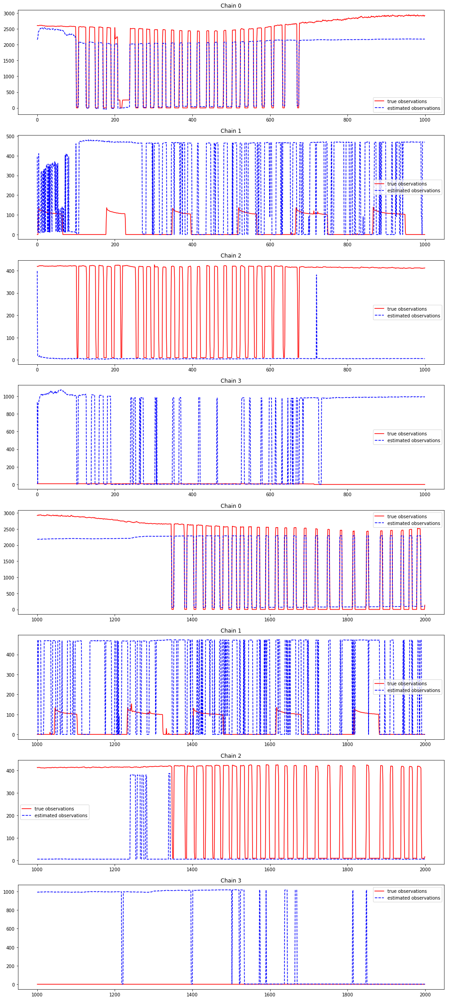

In [74]:
T = 2000
_ = PF_F.fit(observations=observations.values[:T],true_values=true_values.values[:T])

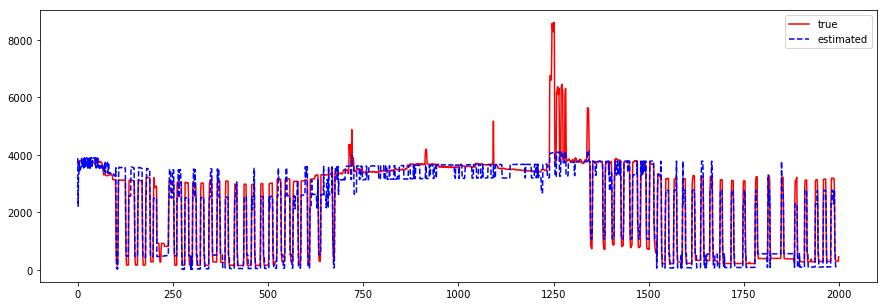

In [93]:
# Comparaison of aggregated powers
plt.figure(figsize=(15,5))
plt.plot(observations.iloc[:T].values.reshape(-1,1),color='red',label='true')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

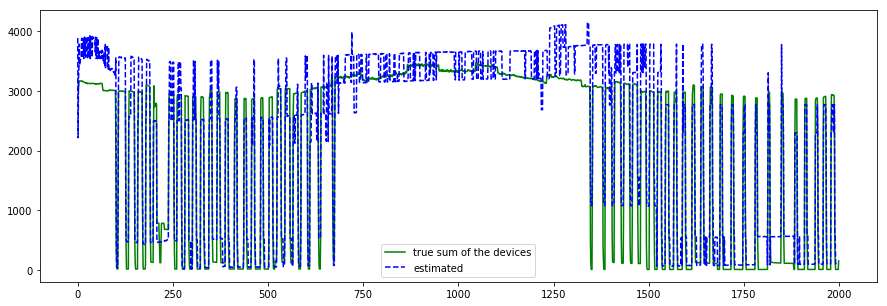

In [95]:
plt.figure(figsize=(15,5))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',label='true sum of the devices')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

### sum of data

In [3]:
import sqlite3

In [127]:
house_id = 1830
devices = ['air','refrigerator','furnace','dishwasher']
classes = ['class 1', 'class 0', 'class 0', 'class 0']

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()



# we stock the data for each device and we change the unit to Watts
true_values = pd.DataFrame([])
for device in devices:
    # we get all the columns (non equal to 0) associated with the device
    device_allcol = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
    chosen_col = [data.loc[:,device_allcol].sum(0).argmax()]
    true_values[device] = data.loc[:,chosen_col]*1000
    
# we stock the data for the aggregated power and we change the unit to Watts
observations = true_values.sum(1)

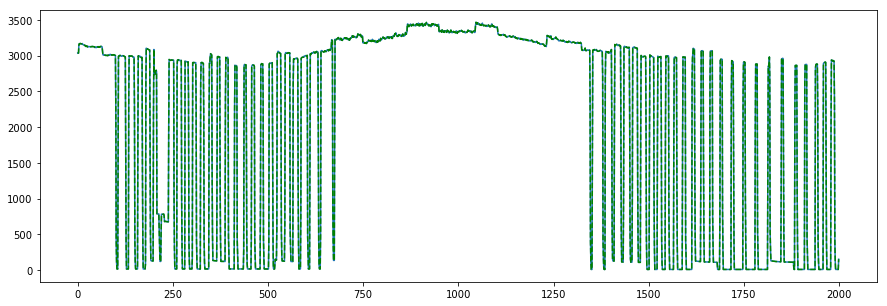

In [129]:
plt.figure(figsize=(15,5))
T = 2000
plt.plot(observations.iloc[:T].values.reshape(-1,1))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',linestyle='--');

In [130]:
priors = pd.read_table('priors.tsv', index_col=[0,1,2])
priors.sort_index(inplace=True)

In [131]:
priors

Obs dist  \
device       class   mode               
air          class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
dishwasher   class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
furnace      class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
refrigerator class 0 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   

                                                                    Obs params  \
device       class   mode                                                        
air          class 0 mode 0  {'mu_0': 48.749114657725947, 'tausq_0': 984.20...   
                     mode 1  {'mu_0': 3401.7622677963004, 'tausq_0': 183436...   
             class 1 mode 0  {'mu_0': 50.887711799790935, 'tausq_0': 2653.1...   
                     mode 1  {'mu_0': 1873.0529361852484, 'tausq_0': 215025...   
dishwasher   class 0 mode 0  {'mu_0': 2.4834949402285185, 'tausq_0': 3.5314...   
                     mode 1  {'mu_0': 904.07199265887357, 'tausq_0': 24174....   
             class 1 mode 0  {'mu_0': 0.0036382419655489927, 'tausq_0': 0.0...   
                     mode 1  {'mu_0': 2.4473684210526314, 'tausq_0': 0.0, '...   
furnace      class 0 mode 0  {'mu_0': 18.799247430169071, 'tausq_0': 115.50...   
                     mode 1  {'mu_0': 393.37424954388678, 'tausq_0': 14215....   
             class 1 mode 0  {'mu_0': 154.94670210526257, 'tausq_0': 43257....   
                     mode 1  {'mu_0': 767.48350789712515, 'tausq_0': 10151....   
refrigerator class 0 mode 0  {'mu_0': 11.003624640937971, 'tausq_0': 117.05...   
                     mode 1  {'mu_0': 111.97297668021551, 'tausq_0': 1904.6...   
                     mode 2  {'mu_0': 370.8776013487041, 'tausq_0': 22599.2...   
             class 1 mode 0  {'mu_0': 52.037733914380929, 'tausq_0': 0.0, '...   
                     mode 1  {'mu_0': 448.72807017543857, 'tausq_0': 0.0, '...   
                     mode 2  {'mu_0': 1416.3757476889614, 'tausq_0': 0.0, '...   

                               Dur dist  \
device       class   mode                 
air          class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
dishwasher   class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
furnace      class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
refrigerator class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   

                                                                    Dur params  
device       class   mode                                                       
air          class 0 mode 0  {'alpha_pi': 46.069723552177628, 'beta_pi': 6....  
                     mode 1  {'alpha_pi': 94.529550261459661, 'beta_pi': 11...  
             class 1 mode 0  {'alpha_pi': 1.0008429522197928, 'beta_pi': 0....  
                     mode 1  {'alpha_pi': 10.251878490370444, 'beta_pi': 1....  
dishwasher   class 0 mode 0  {'alpha_pi': 0.85903071351507654, 'beta_pi': 0...  
                     mode 1  {'alpha_pi': 2.4636918520456361, 'beta_pi': 0....  
             class 1 mode 0  {'alpha_pi': inf, 'beta_pi': 

In [132]:
import ast

params = {'Nb_states': [],'alpha': [],'mu_0':[],'tausq_0':[],'sigmasq':[]}
L = {'air':1,'refrigerator':1,'furnace':1,'dishwasher':1}
for device, device_class in zip(devices,classes):
    list_modes = priors.loc[(device,device_class,slice(None)),].index.get_level_values(priors.index.names[2])
    Nb_states = len(list_modes)
    params['Nb_states'].append(Nb_states*L[device])
    params['alpha'].append(np.repeat(1./(Nb_states*L[device]),Nb_states*L[device]))
    params['mu_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['mu_0'] for mode in list_modes],L[device]))
    params['tausq_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['tausq_0'] for mode in list_modes],L[device]))
    params['sigmasq'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['sigmasq'] for mode in list_modes],L[device]))

In [133]:
params

{'Nb_states': [2, 3, 2, 2],
 'alpha': [array([ 0.5,  0.5]),
  array([ 0.33333333,  0.33333333,  0.33333333]),
  array([ 0.5,  0.5]),
  array([ 0.5,  0.5])],
 'mu_0': [array([   50.8877118 ,  1873.05293619]),
  array([  11.00362464,  111.97297668,  370.87760135]),
  array([  18.79924743,  393.37424954]),
  array([   2.48349494,  904.07199266])],
 'sigmasq': [array([  55326.50097762,  139827.6501846 ]),
  array([  676.75136603,  1010.73433859,  7931.85366485]),
  array([ 2661.84392703,  3400.31378489]),
  array([   702.85860991,  37555.24141573])],
 'tausq_0': [array([   2653.1994221 ,  215025.38710514]),
  array([   117.05715529,   1904.66474252,  22599.234031  ]),
  array([   115.50732973,  14215.27668795]),
  array([  3.53143698e+00,   2.41745225e+04])]}

In [134]:
PF_F = SIR_Factorial_HMM(N=50,buffer=50,Nb_chains=4,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.


/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 1999 done in 0.2578sec   
0.2699sec avg, 539.4635sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[ 0.911229    0.088771  ]
 [ 0.02412768  0.97587232]]
Chain 1
[[  9.79622799e-01   2.02256050e-02   1.51595894e-04]
 [  9.84971106e-01   6.18004524e-03   8.84884876e-03]
 [  3.41307183e-01   3.52939777e-01   3.05753040e-01]]
Chain 2
[[ 0.41568063  0.58431937]
 [ 0.16415682  0.83584318]]
Chain 3
[[ 0.93765973  0.06234027]
 [ 0.04951643  0.95048357]]

--- Estimators of the observations means at the end ---
Chain 0
[ -350.86122863  2114.2469075 ]
Chain 1
[   2.81733882   77.59517276  386.48455596]
Chain 2
[  17.41178191  517.59637965]
Chain 3
[   2.71824835  658.59738546]


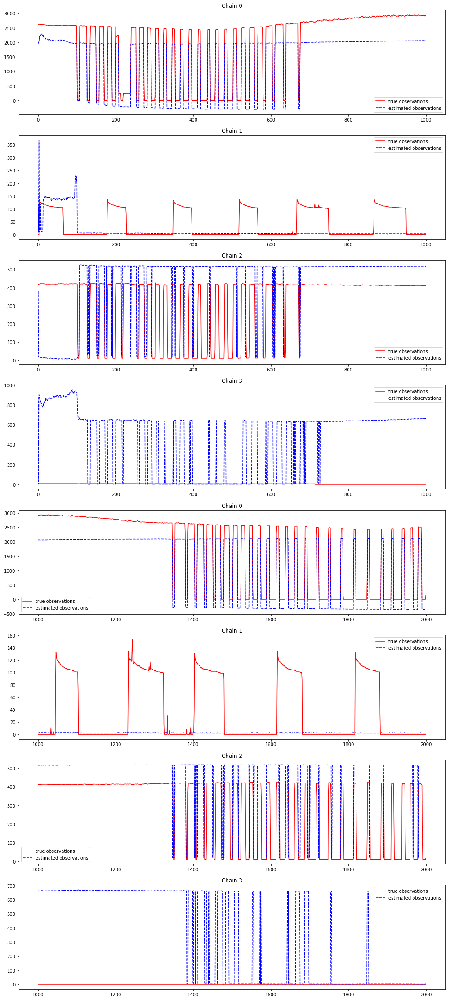

In [135]:
T = 2000
_ = PF_F.fit(observations=observations.values[:T],true_values=true_values.values[:T])

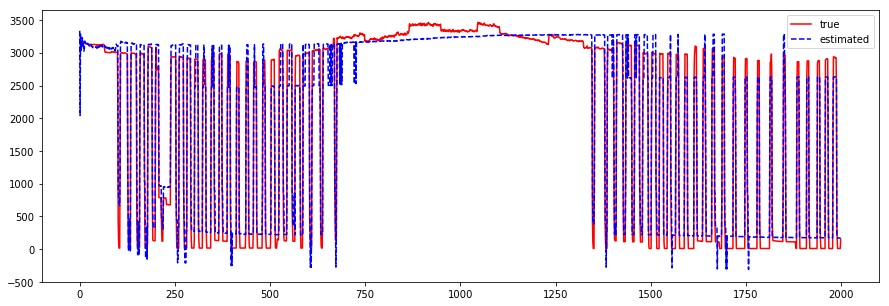

In [136]:
# Comparaison of aggregated powers
plt.figure(figsize=(15,5))
plt.plot(observations.iloc[:T].values.reshape(-1,1),color='red',label='true')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

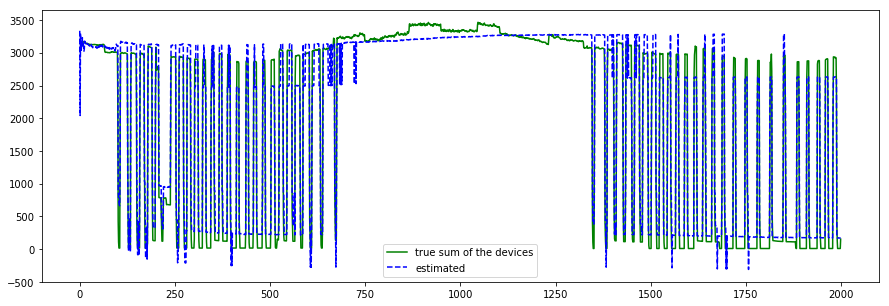

In [137]:
plt.figure(figsize=(15,5))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',label='true sum of the devices')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

In [125]:
PF_F = SIR_Factorial_HMM(N=50,buffer=50,Nb_chains=4,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.


/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 19999 done in 0.2773sec   
0.2695sec avg, 5390.3534sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[ 0.90109268  0.09890732]
 [ 0.01660596  0.98339404]]
Chain 1
[[ 0.94071176  0.01977968  0.03950856]
 [ 0.55512975  0.35016496  0.0947053 ]
 [ 0.11340777  0.80508845  0.08150378]]
Chain 2
[[ 0.91650529  0.08349471]
 [ 0.69448277  0.30551723]]
Chain 3
[[ 0.94197544  0.05802456]
 [ 0.03975703  0.96024297]]

--- Estimators of the observations means at the end ---
Chain 0
[  241.94418254  2713.65333329]
Chain 1
[  -2.97065267   66.21026907  285.74719658]
Chain 2
[  27.86002915  407.328588  ]
Chain 3
[   3.97998676  935.55419183]


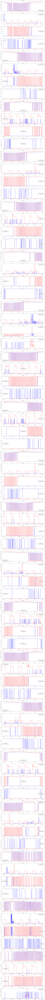

In [126]:
T = 20000
_ = PF_F.fit(observations=observations.values[:T],true_values=true_values.values[:T])

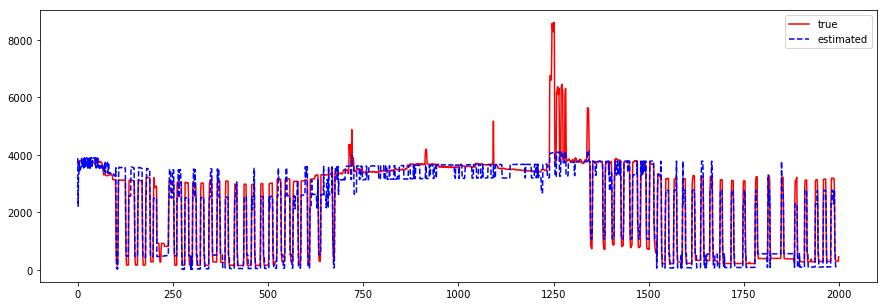

In [93]:
# Comparaison of aggregated powers
plt.figure(figsize=(15,5))
plt.plot(observations.iloc[:T].values.reshape(-1,1),color='red',label='true')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

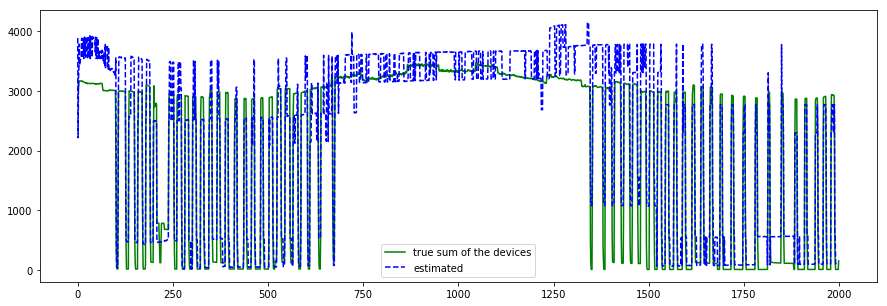

In [95]:
plt.figure(figsize=(15,5))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',label='true sum of the devices')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

### house 946

In [3]:
import sqlite3

In [96]:
house_id = 946
devices = ['air','refrigerator','furnace','dishwasher']
classes = ['class 1', 'class 0', 'class 0', 'class 0']

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()

# we stock the data for the aggregated power and we change the unit to Watts
observations = data.loc[:,'use']*1000

# we stock the data for each device and we change the unit to Watts
true_values = pd.DataFrame([])
for device in devices:
    # we get all the columns (non equal to 0) associated with the device
    device_allcol = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
    chosen_col = [data.loc[:,device_allcol].sum(0).argmax()]
    true_values[device] = data.loc[:,chosen_col]*1000
    

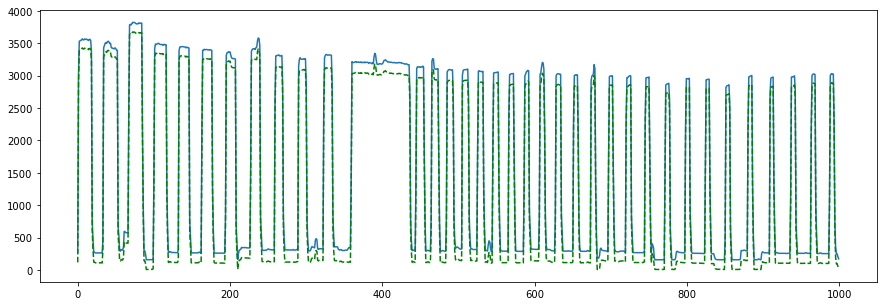

In [98]:
plt.figure(figsize=(15,5))
T = 1000
plt.plot(observations.iloc[T:(T+1000)].values.reshape(-1,1))
plt.plot(true_values.iloc[T:(T+1000)].values.sum(1),color='green',linestyle='--');

In [99]:
priors = pd.read_table('priors.tsv', index_col=[0,1,2])
priors.sort_index(inplace=True)

In [100]:
priors

Obs dist  \
device       class   mode               
air          class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
dishwasher   class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
furnace      class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
refrigerator class 0 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   

                                                                    Obs params  \
device       class   mode                                                        
air          class 0 mode 0  {'mu_0': 48.749114657725947, 'tausq_0': 984.20...   
                     mode 1  {'mu_0': 3401.7622677963004, 'tausq_0': 183436...   
             class 1 mode 0  {'mu_0': 50.887711799790935, 'tausq_0': 2653.1...   
                     mode 1  {'mu_0': 1873.0529361852484, 'tausq_0': 215025...   
dishwasher   class 0 mode 0  {'mu_0': 2.4834949402285185, 'tausq_0': 3.5314...   
                     mode 1  {'mu_0': 904.07199265887357, 'tausq_0': 24174....   
             class 1 mode 0  {'mu_0': 0.0036382419655489927, 'tausq_0': 0.0...   
                     mode 1  {'mu_0': 2.4473684210526314, 'tausq_0': 0.0, '...   
furnace      class 0 mode 0  {'mu_0': 18.799247430169071, 'tausq_0': 115.50...   
                     mode 1  {'mu_0': 393.37424954388678, 'tausq_0': 14215....   
             class 1 mode 0  {'mu_0': 154.94670210526257, 'tausq_0': 43257....   
                     mode 1  {'mu_0': 767.48350789712515, 'tausq_0': 10151....   
refrigerator class 0 mode 0  {'mu_0': 11.003624640937971, 'tausq_0': 117.05...   
                     mode 1  {'mu_0': 111.97297668021551, 'tausq_0': 1904.6...   
                     mode 2  {'mu_0': 370.8776013487041, 'tausq_0': 22599.2...   
             class 1 mode 0  {'mu_0': 52.037733914380929, 'tausq_0': 0.0, '...   
                     mode 1  {'mu_0': 448.72807017543857, 'tausq_0': 0.0, '...   
                     mode 2  {'mu_0': 1416.3757476889614, 'tausq_0': 0.0, '...   

                               Dur dist  \
device       class   mode                 
air          class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
dishwasher   class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
furnace      class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
refrigerator class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   

                                                                    Dur params  
device       class   mode                                                       
air          class 0 mode 0  {'alpha_pi': 46.069723552177628, 'beta_pi': 6....  
                     mode 1  {'alpha_pi': 94.529550261459661, 'beta_pi': 11...  
             class 1 mode 0  {'alpha_pi': 1.0008429522197928, 'beta_pi': 0....  
                     mode 1  {'alpha_pi': 10.251878490370444, 'beta_pi': 1....  
dishwasher   class 0 mode 0  {'alpha_pi': 0.85903071351507654, 'beta_pi': 0...  
                     mode 1  {'alpha_pi': 2.4636918520456361, 'beta_pi': 0....  
             class 1 mode 0  {'alpha_pi': inf, 'beta_pi': 

In [101]:
import ast

params = {'Nb_states': [],'alpha': [],'mu_0':[],'tausq_0':[],'sigmasq':[]}
L = {'air':1,'refrigerator':1,'furnace':1,'dishwasher':1}
for device, device_class in zip(devices,classes):
    list_modes = priors.loc[(device,device_class,slice(None)),].index.get_level_values(priors.index.names[2])
    Nb_states = len(list_modes)
    params['Nb_states'].append(Nb_states*L[device])
    params['alpha'].append(np.repeat(1./(Nb_states*L[device]),Nb_states*L[device]))
    params['mu_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['mu_0'] for mode in list_modes],L[device]))
    params['tausq_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['tausq_0'] for mode in list_modes],L[device]))
    params['sigmasq'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['sigmasq'] for mode in list_modes],L[device]))

In [102]:
params

{'Nb_states': [2, 3, 2, 2],
 'alpha': [array([ 0.5,  0.5]),
  array([ 0.33333333,  0.33333333,  0.33333333]),
  array([ 0.5,  0.5]),
  array([ 0.5,  0.5])],
 'mu_0': [array([   50.8877118 ,  1873.05293619]),
  array([  11.00362464,  111.97297668,  370.87760135]),
  array([  18.79924743,  393.37424954]),
  array([   2.48349494,  904.07199266])],
 'sigmasq': [array([  55326.50097762,  139827.6501846 ]),
  array([  676.75136603,  1010.73433859,  7931.85366485]),
  array([ 2661.84392703,  3400.31378489]),
  array([   702.85860991,  37555.24141573])],
 'tausq_0': [array([   2653.1994221 ,  215025.38710514]),
  array([   117.05715529,   1904.66474252,  22599.234031  ]),
  array([   115.50732973,  14215.27668795]),
  array([  3.53143698e+00,   2.41745225e+04])]}

In [103]:
PF_F = SIR_Factorial_HMM(N=50,buffer=50,Nb_chains=4,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.


/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 1999 done in 0.2576sec   
0.2729sec avg, 545.4373sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[ 0.91877571  0.08122429]
 [ 0.03909386  0.96090614]]
Chain 1
[[ 0.73580601  0.02032192  0.24387207]
 [ 0.48894996  0.37537076  0.13567928]
 [ 0.46522782  0.24559849  0.28917369]]
Chain 2
[[ 0.99693481  0.00306519]
 [ 0.92772546  0.07227454]]
Chain 3
[[ 0.98497041  0.01502959]
 [ 0.95963352  0.04036648]]

--- Estimators of the observations means at the end ---
Chain 0
[  213.92216509  2999.16525087]
Chain 1
[   1.74783749  125.22857277  257.2922793 ]
Chain 2
[   3.06309435  591.65832358]
Chain 3
[    4.28764345  1016.30823593]


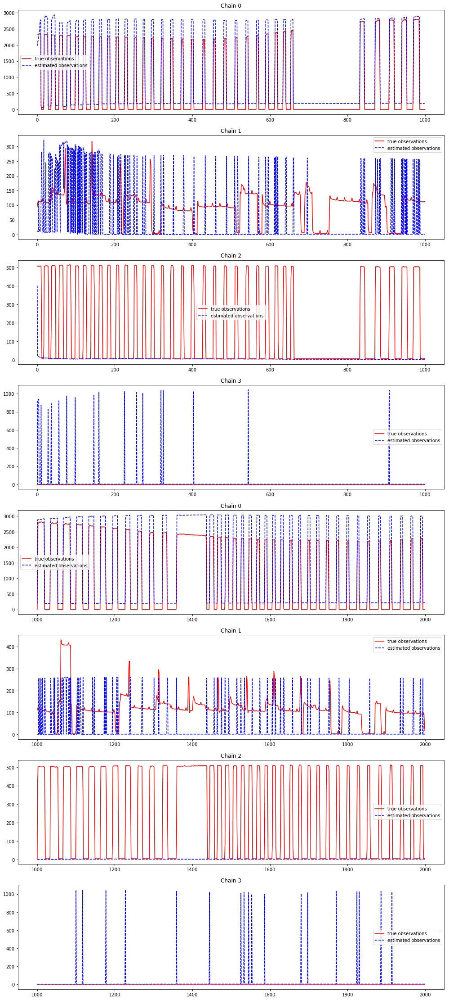

In [104]:
T = 2000
_ = PF_F.fit(observations=observations.values[:T],true_values=true_values.values[:T])

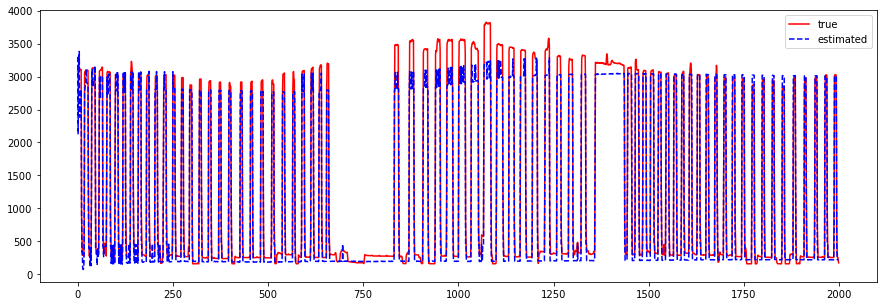

In [105]:
# Comparaison of aggregated powers
plt.figure(figsize=(15,5))
plt.plot(observations.iloc[:T].values.reshape(-1,1),color='red',label='true')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

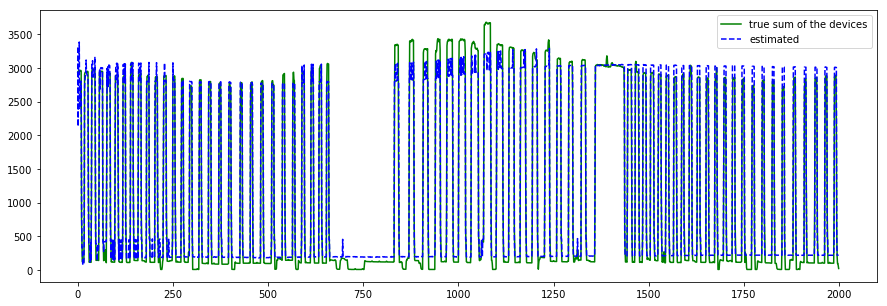

In [106]:
plt.figure(figsize=(15,5))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',label='true sum of the devices')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

### house 661

In [3]:
import sqlite3

In [107]:
house_id = 661
devices = ['air','refrigerator','furnace','dishwasher']
classes = ['class 1', 'class 0', 'class 0', 'class 0']

# we get the data for the house_id
conn = sqlite3.connect('../Data/powers_082016.db')
cursor = conn.cursor()
query = """SELECT * FROM powers WHERE dataid=%d""" % house_id
data = pd.read_sql_query(query, conn)
conn.close()

# we stock the data for the aggregated power and we change the unit to Watts
observations = data.loc[:,'use']*1000

# we stock the data for each device and we change the unit to Watts
true_values = pd.DataFrame([])
for device in devices:
    # we get all the columns (non equal to 0) associated with the device
    device_allcol = [col for col in data.columns if device in col and col[len(device)].isdigit() and data.loc[:,col].sum()>0.]
    chosen_col = [data.loc[:,device_allcol].sum(0).argmax()]
    true_values[device] = data.loc[:,chosen_col]*1000
    

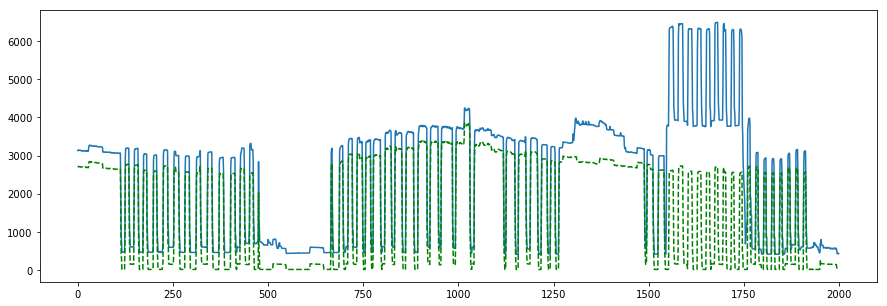

In [117]:
plt.figure(figsize=(15,5))
T = 2000
plt.plot(observations.iloc[:T].values.reshape(-1,1))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',linestyle='--');

In [109]:
priors = pd.read_table('priors.tsv', index_col=[0,1,2])
priors.sort_index(inplace=True)

In [110]:
priors

Obs dist  \
device       class   mode               
air          class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
dishwasher   class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
furnace      class 0 mode 0  gaussian   
                     mode 1  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
refrigerator class 0 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   
             class 1 mode 0  gaussian   
                     mode 1  gaussian   
                     mode 2  gaussian   

                                                                    Obs params  \
device       class   mode                                                        
air          class 0 mode 0  {'mu_0': 48.749114657725947, 'tausq_0': 984.20...   
                     mode 1  {'mu_0': 3401.7622677963004, 'tausq_0': 183436...   
             class 1 mode 0  {'mu_0': 50.887711799790935, 'tausq_0': 2653.1...   
                     mode 1  {'mu_0': 1873.0529361852484, 'tausq_0': 215025...   
dishwasher   class 0 mode 0  {'mu_0': 2.4834949402285185, 'tausq_0': 3.5314...   
                     mode 1  {'mu_0': 904.07199265887357, 'tausq_0': 24174....   
             class 1 mode 0  {'mu_0': 0.0036382419655489927, 'tausq_0': 0.0...   
                     mode 1  {'mu_0': 2.4473684210526314, 'tausq_0': 0.0, '...   
furnace      class 0 mode 0  {'mu_0': 18.799247430169071, 'tausq_0': 115.50...   
                     mode 1  {'mu_0': 393.37424954388678, 'tausq_0': 14215....   
             class 1 mode 0  {'mu_0': 154.94670210526257, 'tausq_0': 43257....   
                     mode 1  {'mu_0': 767.48350789712515, 'tausq_0': 10151....   
refrigerator class 0 mode 0  {'mu_0': 11.003624640937971, 'tausq_0': 117.05...   
                     mode 1  {'mu_0': 111.97297668021551, 'tausq_0': 1904.6...   
                     mode 2  {'mu_0': 370.8776013487041, 'tausq_0': 22599.2...   
             class 1 mode 0  {'mu_0': 52.037733914380929, 'tausq_0': 0.0, '...   
                     mode 1  {'mu_0': 448.72807017543857, 'tausq_0': 0.0, '...   
                     mode 2  {'mu_0': 1416.3757476889614, 'tausq_0': 0.0, '...   

                               Dur dist  \
device       class   mode                 
air          class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
dishwasher   class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
furnace      class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
refrigerator class 0 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   
             class 1 mode 0  pnbMixture   
                     mode 1  pnbMixture   
                     mode 2  pnbMixture   

                                                                    Dur params  
device       class   mode                                                       
air          class 0 mode 0  {'alpha_pi': 46.069723552177628, 'beta_pi': 6....  
                     mode 1  {'alpha_pi': 94.529550261459661, 'beta_pi': 11...  
             class 1 mode 0  {'alpha_pi': 1.0008429522197928, 'beta_pi': 0....  
                     mode 1  {'alpha_pi': 10.251878490370444, 'beta_pi': 1....  
dishwasher   class 0 mode 0  {'alpha_pi': 0.85903071351507654, 'beta_pi': 0...  
                     mode 1  {'alpha_pi': 2.4636918520456361, 'beta_pi': 0....  
             class 1 mode 0  {'alpha_pi': inf, 'beta_pi': 

In [111]:
import ast

params = {'Nb_states': [],'alpha': [],'mu_0':[],'tausq_0':[],'sigmasq':[]}
L = {'air':1,'refrigerator':1,'furnace':1,'dishwasher':1}
for device, device_class in zip(devices,classes):
    list_modes = priors.loc[(device,device_class,slice(None)),].index.get_level_values(priors.index.names[2])
    Nb_states = len(list_modes)
    params['Nb_states'].append(Nb_states*L[device])
    params['alpha'].append(np.repeat(1./(Nb_states*L[device]),Nb_states*L[device]))
    params['mu_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['mu_0'] for mode in list_modes],L[device]))
    params['tausq_0'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['tausq_0'] for mode in list_modes],L[device]))
    params['sigmasq'].append(np.repeat([ast.literal_eval(priors.loc[(device,device_class,mode),'Obs params'])['sigmasq'] for mode in list_modes],L[device]))

In [112]:
params

{'Nb_states': [2, 3, 2, 2],
 'alpha': [array([ 0.5,  0.5]),
  array([ 0.33333333,  0.33333333,  0.33333333]),
  array([ 0.5,  0.5]),
  array([ 0.5,  0.5])],
 'mu_0': [array([   50.8877118 ,  1873.05293619]),
  array([  11.00362464,  111.97297668,  370.87760135]),
  array([  18.79924743,  393.37424954]),
  array([   2.48349494,  904.07199266])],
 'sigmasq': [array([  55326.50097762,  139827.6501846 ]),
  array([  676.75136603,  1010.73433859,  7931.85366485]),
  array([ 2661.84392703,  3400.31378489]),
  array([   702.85860991,  37555.24141573])],
 'tausq_0': [array([   2653.1994221 ,  215025.38710514]),
  array([   117.05715529,   1904.66474252,  22599.234031  ]),
  array([   115.50732973,  14215.27668795]),
  array([  3.53143698e+00,   2.41745225e+04])]}

In [113]:
PF_F = SIR_Factorial_HMM(N=50,buffer=50,Nb_chains=4,**params)

/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:106: RuntimeWarning: covariance is not positive-semidefinite.


/home/ROCQ/dyogene/acadas/anaconda3/envs/hmm/lib/python3.6/site-packages/ipykernel_launcher.py:220: RuntimeWarning: covariance is not positive-semidefinite.


Step 1999 done in 0.2562sec   
0.2654sec avg, 530.5500sec total

--- Estimators of the transition matrix at the end ---
Chain 0
[[ 0.91709163  0.08290837]
 [ 0.02233965  0.97766035]]
Chain 1
[[ 0.6191261   0.18706662  0.19380728]
 [ 0.95124819  0.02470747  0.02404434]
 [ 0.48133354  0.2139846   0.30468186]]
Chain 2
[[ 0.93425267  0.06574733]
 [ 0.63866853  0.36133147]]
Chain 3
[[ 0.94580118  0.05419882]
 [ 0.04890148  0.95109852]]

--- Estimators of the observations means at the end ---
Chain 0
[  422.34047184  2288.79852582]
Chain 1
[  21.13463141  163.70816447  273.6662641 ]
Chain 2
[  11.66900727  451.36586203]
Chain 3
[  5.89965357e-01   1.20579120e+03]


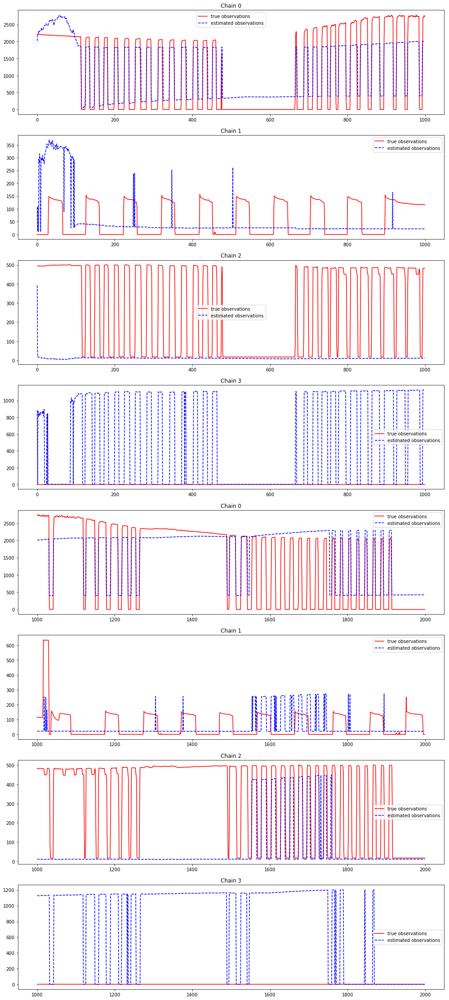

In [114]:
T = 2000
_ = PF_F.fit(observations=observations.values[:T],true_values=true_values.values[:T])

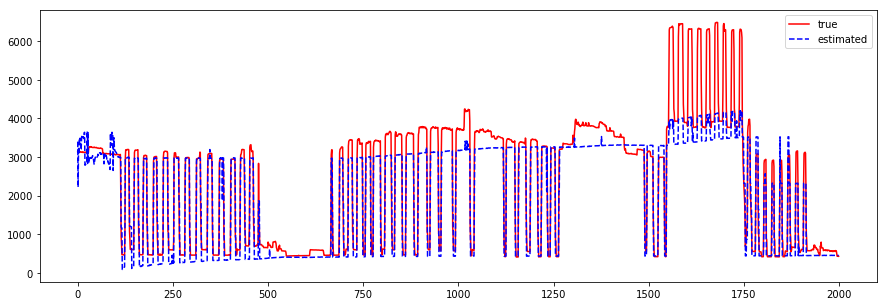

In [115]:
# Comparaison of aggregated powers
plt.figure(figsize=(15,5))
plt.plot(observations.iloc[:T].values.reshape(-1,1),color='red',label='true')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');

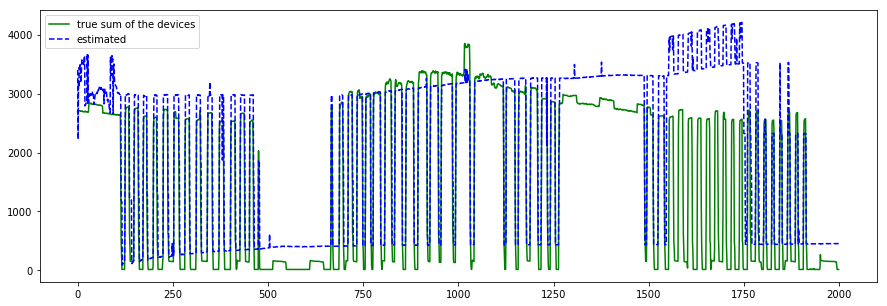

In [116]:
plt.figure(figsize=(15,5))
plt.plot(true_values.iloc[:T].values.sum(1),color='green',label='true sum of the devices')
plt.plot(_[0],linestyle='--',color='blue',label='estimated')
plt.legend(loc='best');